In [1]:
import pandas as pd

df = pd.read_excel('Censos Dataset por Concelho.xlsx', header=[0,1])
df.set_index('Unnamed: 0_level_0', inplace=True)
df.rename_axis('Concelho', inplace=True)
df_feminino = df['Feminino']
df_masculino = df['Masculino']

# Distribuição de Género por cada grupo etário

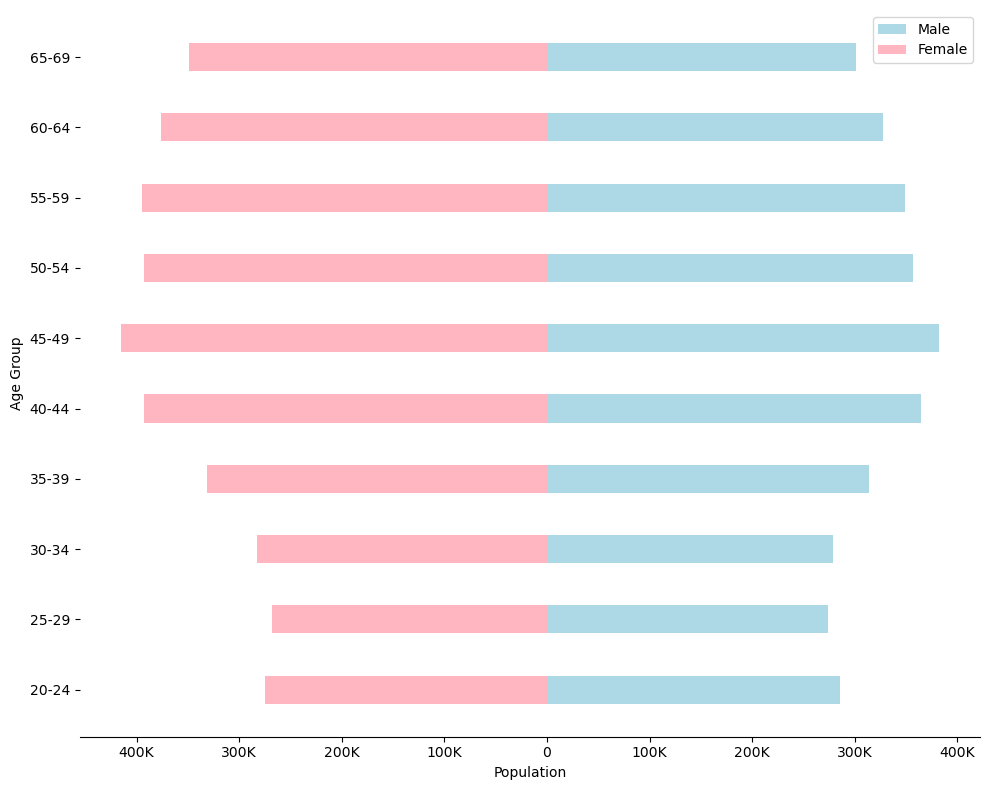

In [22]:
import matplotlib.pyplot as plt
import pandas as pd

# Sum the values for each age group across all municipalities
total_feminino_by_age = df_feminino.sum()
total_masculino_by_age = df_masculino.sum()

# Combine the two Series into a DataFrame for plotting
df_merged = pd.concat([total_feminino_by_age, total_masculino_by_age], axis=1)
df_merged.columns = ['Female', 'Male']

# Calculate the maximum population to set y-axis limit
max_population = max(df_merged.max())

# Create the figure and axes
fig, ax = plt.subplots(figsize=(10, 8))

# Plot the male population as bars with positive width
ax.barh(df_merged.index, df_merged['Male'], color='lightblue', label='Male', height=0.4)

# Plot the female population as bars with negative width
ax.barh(df_merged.index, -df_merged['Female'], color='lightpink', label='Female', height=0.4)

ax.set_xlabel('Population')
ax.set_ylabel('Age Group')

plt.xticks(ticks=[-400000, -300000, -200000, -100000, 0, 100000, 200000, 300000, 400000],
labels=['400K', '300K', '200K', '100K', '0', '100K', '200K', '300K', '400K'])
# Remove spines
ax.spines['left'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

# Add legend with custom labels
ax.legend(['Male', 'Female'])


# Show the plot
plt.tight_layout()
plt.show()

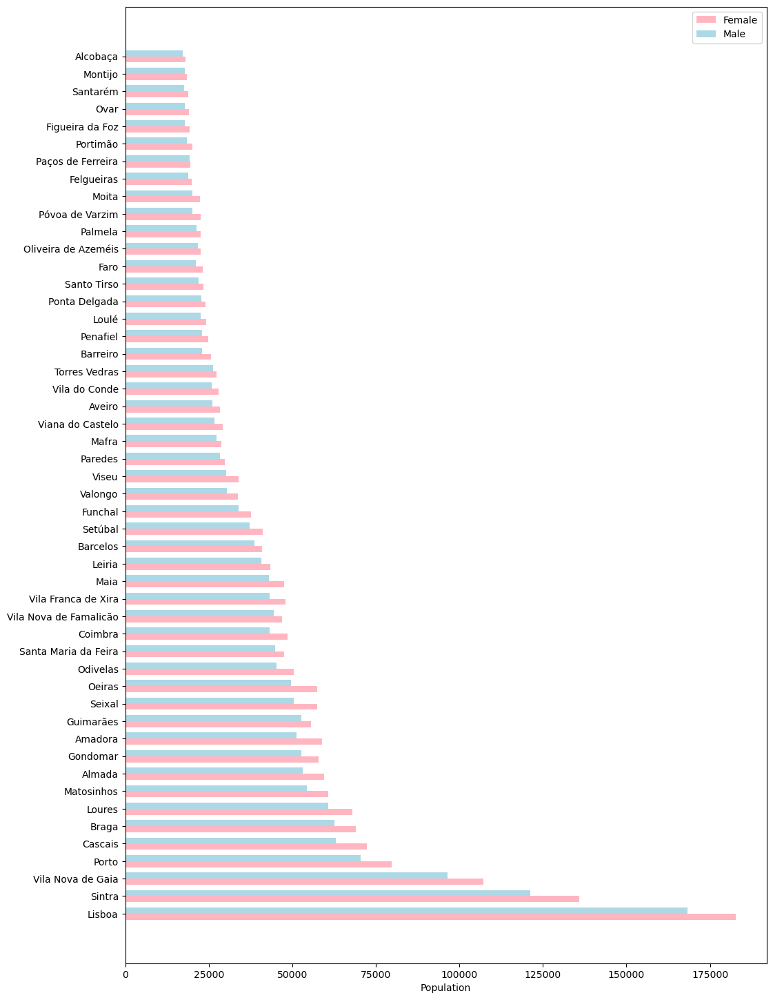

In [23]:
import numpy as np

df_total = df.groupby(level=0, axis=1).sum()

# Clean the municipality names
df_total.index = [str(muni[0]) for muni in df_total.index]

test = df_total.sum(axis=1)
# Sort the DataFrame by the total population
df_total_sorted = df_total.sum(axis=1).sort_values(ascending=False)

# Select the top 50 municipalities
top_50_municipalities = df_total_sorted.head(50)

# Set the figure size
plt.figure(figsize=(12, 18))

# Get the list of municipalities with leading and trailing spaces removed
municipalities = [str(muni) for muni in top_50_municipalities.index.tolist()]

# Get the values for the feminine and masculine columns
feminine_values = top_50_municipalities.index.map(lambda x: df_total.loc[x]['Feminino']).values
masculine_values = top_50_municipalities.index.map(lambda x: df_total.loc[x]['Masculino']).values

# Set the bar width
bar_width = 0.35

# Set the positions of the bars on the x-axis
r1 = np.arange(len(municipalities))
r2 = [x + bar_width for x in r1]

# Plot the feminine bars
plt.barh(r1, feminine_values, bar_width, color='lightpink', label='Female')

# Plot the masculine bars
plt.barh(r2, masculine_values, bar_width, color='lightblue', label='Male')

# Set the yticks with the municipalities
plt.yticks([(r1 + r2) / 2 for r1, r2 in zip(r1, r2)], municipalities)

# Set the x-axis label

# Set the x-axis label
plt.xlabel('Population')


# Add a legend with increased font size
plt.legend()

# Show the plot
plt.show()



# Filtro de colheitas de 2020

In [25]:
import pandas as pd

collections = pd.read_csv('../colheitas_10-05-2021.csv', sep=';')

mask_approved_collection = (collections['colheita_fase'] == 'E') & (collections['colheita_estado'] == 'O')

dropped_records = collections[~mask_approved_collection].copy()

collections = collections[mask_approved_collection]

C:\Users\gonca\AppData\Local\Temp\ipykernel_8872\939462993.py:3: DtypeWarning: Columns (37,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53) have mixed types. Specify dtype option on import or set low_memory=False.
  collections = pd.read_csv('../colheitas_10-05-2021.csv', sep=';')


In [26]:
collections['colheita_data'] = pd.to_datetime(collections['colheita_data'])

begin_date = pd.Timestamp('2020-01-01')
end_date = pd.Timestamp('2021-01-01')

mask_date = (collections['colheita_data'] >= begin_date) & (collections['colheita_data'] < end_date)
collections = collections[mask_date]

# Distribuição de concelhos nas colheitas

In [100]:
import pandas as pd

collections_2020 = pd.read_excel('collections_2020.xlsx')

conversor_postal_codes_to_municipalities = pd.read_excel('converter_postal_codes_municipalities.xlsx')

KeyboardInterrupt: 

In [29]:

# Eliminar missing values nos codigos Postais
collections_2020.dropna(subset=['dador_codigo_postal_primeiras_posicoes'], inplace=True)

# Eliminar invalid values nos sexos
collections_2020 = collections_2020[~(collections_2020['dador_sexo'] == 'indefinido')]

# Adicionar coluna da idade
collections_2020["dador_data_nascimento"] = pd.to_datetime(collections_2020["dador_data_nascimento"])
collections_2020["colheita_data"] = pd.to_datetime(collections_2020["colheita_data"])
collections_2020["idade"] = collections_2020["colheita_data"].dt.year - collections_2020["dador_data_nascimento"].dt.year

# Adicionar coluna do municipio de forma a não ter missing ou invalid values
blood_collections = collections_2020.merge(conversor_postal_codes_to_municipalities, left_on='dador_codigo_postal_primeiras_posicoes', right_on='Codigo Postal', how='left')

In [33]:
# Seleção das features relevantes
columns_to_have = ["dador_nr", "dador_data_nascimento", "colheita_data", "idade", "dador_sexo", "dador_codigo_postal_primeiras_posicoes", "Codigo Postal", "Concelho", "dador_tipo_sangue_abo", "dador_tipo_sangue_rh", "dador_total_dadivas", "dador_total_dadivas_ipst"]
blood_collections_filtered = blood_collections[columns_to_have]

# Exportar para excel
blood_collections_filtered.to_excel('blood_collections_filtered.xlsx', index=False)


In [80]:
import pandas as pd

df_ready = pd.read_excel('blood_collections_filtered.xlsx')

# Excluir os menores de 20 anos visto que os censos nao contabilizam entre 18 a 20 anos
df_ready = df_ready[~(df_ready['idade'] < 20)]

age_bins = [19, 24, 29, 34, 39, 44, 49, 54, 59, 64, 69]
age_labels = ['20-24', '25-29', '30-34', '35-39', '40-44', '45-49', '50-54', '55-59', '60-64', '65-69']

# Create the age groups
df_ready['age_group'] = pd.cut(df_ready['idade'], bins=age_bins, labels=age_labels, right=False)

# Criar a tabela que mostra a contagem de dadores por concelho, sexo e grupo etário
pivot_df = df_ready.pivot_table(
    index=['Concelho', 'dador_sexo', 'age_group'],
    aggfunc='size'
).reset_index(name='count')

pivot_df['dador_sexo'] = pivot_df['dador_sexo'].str.capitalize()

In [81]:
import pandas as pd

census = pd.read_excel('melted_census_data.xlsx')

df_merged = census.merge(pivot_df, right_on=['Concelho', 'dador_sexo','age_group'],left_on=['Concelho', 'Sexo', 'Faxa Etaria'], how='left')
df_merged.drop(columns=['dador_sexo', 'age_group'], inplace=True)
df_merged.fillna(0, inplace=True)
df_merged.rename(columns={'count': 'Numero de Colheitas Realizadas'}, inplace=True)
df_merged['Taxa Doacao (%)'] = 2.8# Existem 6711893 pessoas entre os 20 e 69 anos em Portugal e 188601 dadores de sangue em 2020 que realizaram dadivas
df_merged['Potencial de Colheitas'] = df_merged['Numero Populacional'] * df_merged['Taxa Doacao (%)'] / 100 * df_merged['Sexo'].apply(lambda x: 3 if x == 'Feminino' else 4)


# Municipalities excluded (25%)

In [82]:
test_df = df_merged.pivot_table(index='Concelho', values=['Numero Populacional'], aggfunc='sum')
print(test_df['Numero Populacional'].sum())
first_quartile_value = test_df['Numero Populacional'].quantile(0.25)
print(first_quartile_value)
excludes_municipalities = test_df[test_df['Numero Populacional'] < first_quartile_value].index.tolist()


6711893
3832.0


# Collections Saturation per Municipality

In [83]:
concelho_df = df_merged.pivot_table(index='Concelho', values=['Numero de Colheitas Realizadas','Numero Populacional', 'Potencial de Colheitas'], aggfunc='sum')

concelho_df = concelho_df[~concelho_df.index.isin(excludes_municipalities)]

concelho_df["Saturation (%)"] = concelho_df["Numero de Colheitas Realizadas"] / concelho_df["Potencial de Colheitas"] * 100

concelho_df.sort_values(by='Saturation (%)', ascending=False, inplace=True)

print(concelho_df['Saturation (%)'].head(10))

Concelho
Arouca                  96.875936
Vizela                  81.333356
Vale de Cambra          78.895995
Alpiarça                77.597579
Santa Maria da Feira    74.166001
Lamego                  70.383063
Santarém                69.436463
Guimarães               66.869373
Marco de Canaveses      60.505027
Murtosa                 55.762198
Name: Saturation (%), dtype: float64


# Collections Saturation per Gender

Sexo
Feminino     28.509469
Masculino    23.915552
Name: Saturation (%), dtype: float64


<Axes: xlabel='Sexo'>

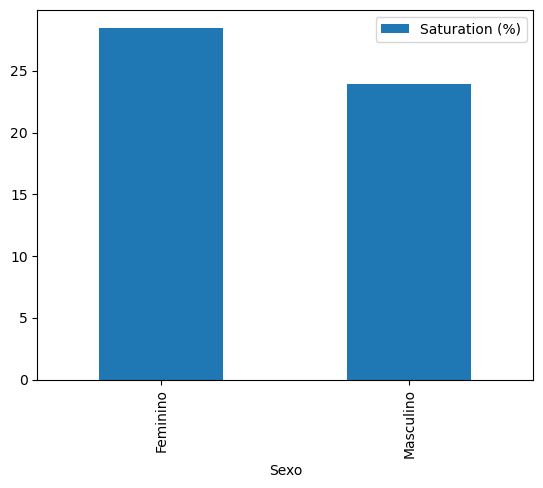

In [128]:
gender_df = df_merged.pivot_table(index='Sexo', values=['Numero de Colheitas Realizadas', 'Potencial de Colheitas'], aggfunc='sum')

gender_df["Saturation (%)"] = gender_df["Numero de Colheitas Realizadas"] / gender_df["Potencial de Colheitas"] * 100

gender_df.sort_values(by='Saturation (%)', ascending=False, inplace=True)

print(gender_df['Saturation (%)'].head(10))

gender_df.plot(kind='bar', y='Saturation (%)', legend=True)

# Collections Saturation per Group Age

Faxa Etaria
20-24    21.419634
25-29    27.154969
30-34    27.845984
35-39    28.331073
40-44    34.181715
45-49    37.682826
50-54    31.925876
55-59    24.949902
60-64    16.596181
65-69     5.364796
Name: Saturation (%), dtype: float64


<Axes: xlabel='Faxa Etaria'>

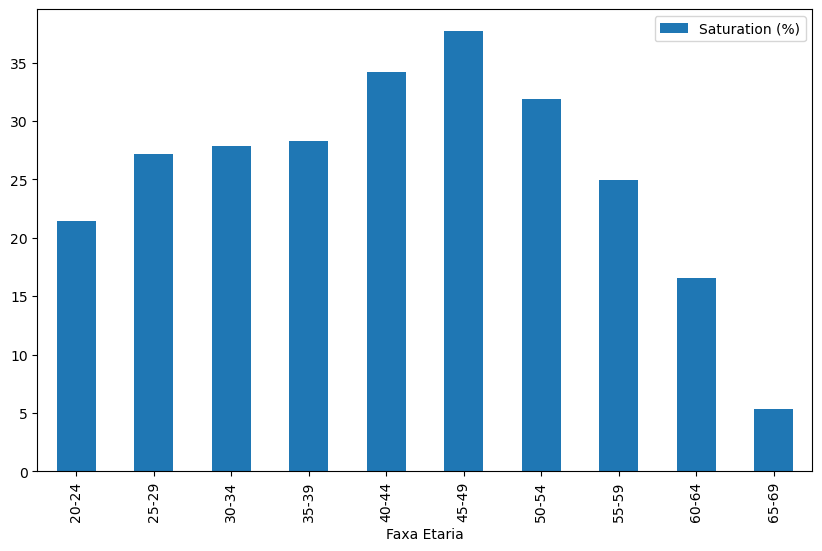

In [129]:
age_group_df = df_merged.pivot_table(index='Faxa Etaria', values=['Numero de Colheitas Realizadas', 'Potencial de Colheitas'], aggfunc='sum')

age_group_df["Saturation (%)"] = age_group_df["Numero de Colheitas Realizadas"] / age_group_df["Potencial de Colheitas"] * 100

age_group_df.sort_values(by='Faxa Etaria', ascending=True, inplace=True)

print(age_group_df['Saturation (%)'].head(10))


age_group_df.plot(kind='bar', y='Saturation (%)', figsize=(10, 6))

# MAPA PORTUGAL SATURAÇÃO CONCELHO

In [84]:
%matplotlib inline

import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt

uf_pt2 = gpd.read_file('Geopandas_Portugal/Shapes/shp/gadm36_PRT_2.shp')

In [85]:
uf_pt2 = uf_pt2[uf_pt2['NAME_1'] != 'Azores']
uf_pt2 = uf_pt2[uf_pt2['NAME_1'] != 'Madeira']

mapa_df_concelho = uf_pt2.merge(concelho_df, left_on='NAME_2', right_on='Concelho', how='left')

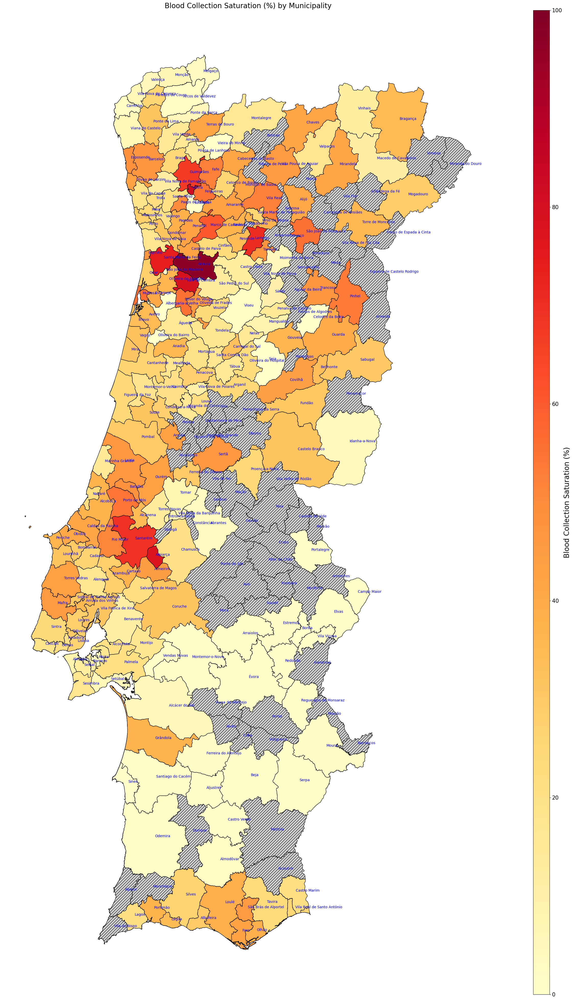

In [89]:
# Copy uf_pt2 and calculate centroids
points2 = uf_pt2.copy()

# Reproject to a projected CRS (e.g., EPSG:3857)
points2 = points2.to_crs(epsg=3857)
points2.geometry = points2.geometry.centroid

# Reproject back to the original CRS if needed
points2 = points2.to_crs(uf_pt2.crs)

# Plot the GeoDataFrame with the new 'Values' column, specifying NaN color
fig, ax = plt.subplots(figsize=(40, 50))
mapa_df_concelho.plot(column='Saturation (%)', vmin=0, vmax=100, edgecolor = 'black',cmap='YlOrRd', legend=False,
            missing_kwds={
                "color": "lightgrey",
                "edgecolor": "black",
                "hatch": "///",
                "label": "Missing values",
            }, ax=ax)
ax.set_axis_off()

cbar = plt.cm.ScalarMappable(cmap='YlOrRd', norm=plt.Normalize(vmin=0, vmax=100))
cbar.set_array([])

# Set the aspect ratio to control the thickness
colorbar = fig.colorbar(cbar, ax=ax, orientation='vertical', aspect=60, ticks=[0, 20, 40, 60, 80, 100])
colorbar.set_label('Blood Collection Saturation (%)', fontsize=20)  # Set the label font size
colorbar.ax.tick_params(labelsize=15)  # Set the ticks font size

# Set custom tick labels if desired
colorbar.set_ticks([0, 20, 40, 60, 80, 100])
colorbar.set_ticklabels(['0', '20', '40', '60', '80', '100']) # Set the ticks font size

# Annotate the plot
for x, y, label in zip(points2.geometry.x, points2.geometry.y, points2.NAME_2):
    ax.annotate(label, xy=(x, y), xytext=(3, 3), textcoords="offset points", color='blue')

# Display the plot
plt.title('Blood Collection Saturation (%) by Municipality', fontsize=20)   
plt.show()

# Mapa Saturação Sexo Feminino Concelho

In [65]:
import pandas as pd

df_ready = pd.read_excel('blood_collections_filtered.xlsx')

# Excluir os menores de 20 anos visto que os censos nao contabilizam entre 18 a 20 anos
df_ready = df_ready[~(df_ready['idade'] < 20)]

age_bins = [19, 24, 29, 34, 39, 44, 49, 54, 59, 64, 69]
age_labels = ['20-24', '25-29', '30-34', '35-39', '40-44', '45-49', '50-54', '55-59', '60-64', '65-69']

# Create the age groups
df_ready['age_group'] = pd.cut(df_ready['idade'], bins=age_bins, labels=age_labels, right=False)

# Criar a tabela que mostra a contagem de dadores por concelho, sexo e grupo etário
pivot_df = df_ready.pivot_table(
    index=['Concelho', 'dador_sexo', 'age_group'],
    aggfunc='size'
).reset_index(name='count')

pivot_df['dador_sexo'] = pivot_df['dador_sexo'].str.capitalize()

pivot_df = pivot_df[pivot_df['dador_sexo'] != 'Masculino']

In [66]:
import pandas as pd

census = pd.read_excel('melted_census_data.xlsx')
census = census[census['Sexo'] == 'Feminino']


df_merged = census.merge(pivot_df, right_on=['Concelho', 'dador_sexo','age_group'],left_on=['Concelho', 'Sexo', 'Faxa Etaria'], how='left')
df_merged.drop(columns=['dador_sexo', 'age_group'], inplace=True)
df_merged.fillna(0, inplace=True)
df_merged.rename(columns={'count': 'Numero de Colheitas Realizadas'}, inplace=True)
df_merged['Taxa Doacao (%)'] = 2.8# Existem 6711893 pessoas entre os 20 e 69 anos em Portugal e 188601 dadores de sangue em 2020 que realizaram dadivas
df_merged['Potencial de Colheitas'] = df_merged['Numero Populacional'] * df_merged['Taxa Doacao (%)'] / 100 * df_merged['Sexo'].apply(lambda x: 3 if x == 'Feminino' else 4)


In [67]:
test_df = df_merged.pivot_table(index='Concelho', values=['Numero Populacional'], aggfunc='sum')
print(test_df['Numero Populacional'].sum())
first_quartile_value = test_df['Numero Populacional'].quantile(0.25)
print(first_quartile_value)
excludes_municipalities = test_df[test_df['Numero Populacional'] < first_quartile_value].index.tolist()

3480172
1921.5


In [68]:
concelho_df = df_merged.pivot_table(index='Concelho', values=['Numero de Colheitas Realizadas','Numero Populacional', 'Potencial de Colheitas'], aggfunc='sum')

concelho_df = concelho_df[~concelho_df.index.isin(excludes_municipalities)]

concelho_df["Saturation (%)"] = concelho_df["Numero de Colheitas Realizadas"] / concelho_df["Potencial de Colheitas"] * 100

concelho_df.sort_values(by='Saturation (%)', ascending=False, inplace=True)

print(concelho_df['Saturation (%)'].head(10))

Concelho
Arouca                  115.190785
Vizela                  101.869373
Vale de Cambra           96.811713
Marco de Canaveses       86.735080
Santa Maria da Feira     84.781464
Lamego                   80.599883
Guimarães                74.774668
Terras de Bouro          70.097312
Paços de Ferreira        69.479966
Alpiarça                 69.188192
Name: Saturation (%), dtype: float64


In [69]:
%matplotlib inline

import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt

uf_pt2 = gpd.read_file('Geopandas_Portugal/Shapes/shp/gadm36_PRT_2.shp')

In [70]:
uf_pt2 = uf_pt2[uf_pt2['NAME_1'] != 'Azores']
uf_pt2 = uf_pt2[uf_pt2['NAME_1'] != 'Madeira']

mapa_df_concelho = uf_pt2.merge(concelho_df, left_on='NAME_2', right_on='Concelho', how='left')

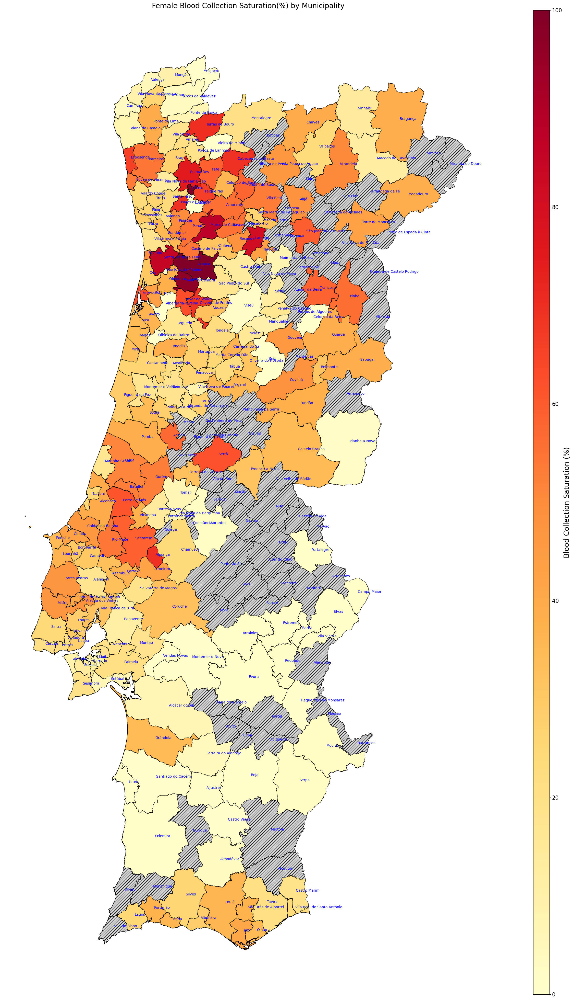

In [71]:
# Copy uf_pt2 and calculate centroids
points2 = uf_pt2.copy()

# Reproject to a projected CRS (e.g., EPSG:3857)
points2 = points2.to_crs(epsg=3857)
points2.geometry = points2.geometry.centroid

# Reproject back to the original CRS if needed
points2 = points2.to_crs(uf_pt2.crs)

# Plot the GeoDataFrame with the new 'Values' column, specifying NaN color
fig, ax = plt.subplots(figsize=(40, 50))
mapa_df_concelho.plot(column='Saturation (%)', vmin=0, vmax=100, edgecolor = 'black',cmap='YlOrRd', legend=False,
            missing_kwds={
                "color": "lightgrey",
                "edgecolor": "black",
                "hatch": "///",
                "label": "Missing values",
            }, ax=ax)
ax.set_axis_off()

cbar = plt.cm.ScalarMappable(cmap='YlOrRd', norm=plt.Normalize(vmin=0, vmax=100))
cbar.set_array([])

# Set the aspect ratio to control the thickness
colorbar = fig.colorbar(cbar, ax=ax, orientation='vertical', aspect=60, ticks=[0, 20, 40, 60, 80, 100])
colorbar.set_label('Blood Collection Saturation (%)', fontsize=20)  # Set the label font size
colorbar.ax.tick_params(labelsize=15)  # Set the ticks font size

# Set custom tick labels if desired
colorbar.set_ticks([0, 20, 40, 60, 80, 100])
colorbar.set_ticklabels(['0', '20', '40', '60', '80', '100']) # Set the ticks font size

# Annotate the plot
for x, y, label in zip(points2.geometry.x, points2.geometry.y, points2.NAME_2):
    ax.annotate(label, xy=(x, y), xytext=(3, 3), textcoords="offset points", color='blue')

# Display the plot
plt.title('Female Blood Collection Saturation(%) by Municipality', fontsize=20)   
plt.show()

# Mapa Saturação Sexo Masculino Concelho

In [72]:
import pandas as pd

df_ready = pd.read_excel('blood_collections_filtered.xlsx')

# Excluir os menores de 20 anos visto que os censos nao contabilizam entre 18 a 20 anos
df_ready = df_ready[~(df_ready['idade'] < 20)]

age_bins = [19, 24, 29, 34, 39, 44, 49, 54, 59, 64, 69]
age_labels = ['20-24', '25-29', '30-34', '35-39', '40-44', '45-49', '50-54', '55-59', '60-64', '65-69']

# Create the age groups
df_ready['age_group'] = pd.cut(df_ready['idade'], bins=age_bins, labels=age_labels, right=False)

# Criar a tabela que mostra a contagem de dadores por concelho, sexo e grupo etário
pivot_df = df_ready.pivot_table(
    index=['Concelho', 'dador_sexo', 'age_group'],
    aggfunc='size'
).reset_index(name='count')

pivot_df['dador_sexo'] = pivot_df['dador_sexo'].str.capitalize()

pivot_df = pivot_df[pivot_df['dador_sexo'] != 'Feminino']

In [74]:
import pandas as pd

census = pd.read_excel('melted_census_data.xlsx')
census = census[census['Sexo'] == 'Masculino']


df_merged = census.merge(pivot_df, right_on=['Concelho', 'dador_sexo','age_group'],left_on=['Concelho', 'Sexo', 'Faxa Etaria'], how='left')
df_merged.drop(columns=['dador_sexo', 'age_group'], inplace=True)
df_merged.fillna(0, inplace=True)
df_merged.rename(columns={'count': 'Numero de Colheitas Realizadas'}, inplace=True)
df_merged['Taxa Doacao (%)'] = 2.8# Existem 6711893 pessoas entre os 20 e 69 anos em Portugal e 188601 dadores de sangue em 2020 que realizaram dadivas
df_merged['Potencial de Colheitas'] = df_merged['Numero Populacional'] * df_merged['Taxa Doacao (%)'] / 100 * df_merged['Sexo'].apply(lambda x: 3 if x == 'Feminino' else 4)


In [75]:
test_df = df_merged.pivot_table(index='Concelho', values=['Numero Populacional'], aggfunc='sum')
print(test_df['Numero Populacional'].sum())
first_quartile_value = test_df['Numero Populacional'].quantile(0.25)
print(first_quartile_value)
excludes_municipalities = test_df[test_df['Numero Populacional'] < first_quartile_value].index.tolist()

3231721
1926.0


In [76]:
concelho_df = df_merged.pivot_table(index='Concelho', values=['Numero de Colheitas Realizadas','Numero Populacional', 'Potencial de Colheitas'], aggfunc='sum')

concelho_df = concelho_df[~concelho_df.index.isin(excludes_municipalities)]

concelho_df["Saturation (%)"] = concelho_df["Numero de Colheitas Realizadas"] / concelho_df["Potencial de Colheitas"] * 100

concelho_df.sort_values(by='Saturation (%)', ascending=False, inplace=True)

print(concelho_df['Saturation (%)'].head(10))

Concelho
Alpiarça                 84.248193
Arouca                   82.904427
Santarém                 77.901988
Santa Maria da Feira     65.742557
Vizela                   65.462530
Vale de Cambra           64.954425
Lamego                   62.284356
Guimarães                60.620033
São João da Pesqueira    51.963048
Pinhel                   51.826108
Name: Saturation (%), dtype: float64


In [77]:
%matplotlib inline

import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt

uf_pt2 = gpd.read_file('Geopandas_Portugal/Shapes/shp/gadm36_PRT_2.shp')

In [78]:
uf_pt2 = uf_pt2[uf_pt2['NAME_1'] != 'Azores']
uf_pt2 = uf_pt2[uf_pt2['NAME_1'] != 'Madeira']

mapa_df_concelho = uf_pt2.merge(concelho_df, left_on='NAME_2', right_on='Concelho', how='left')

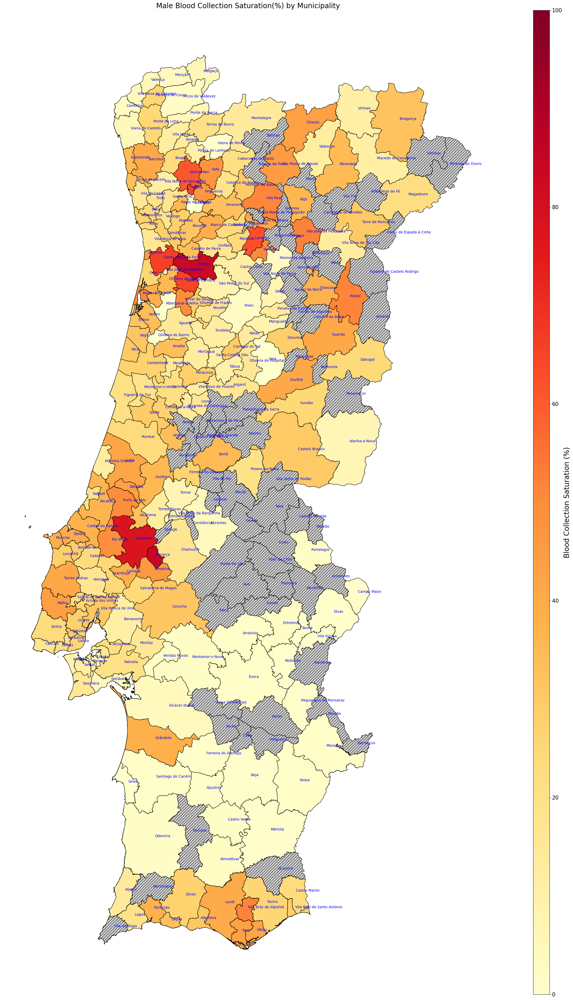

In [79]:
# Copy uf_pt2 and calculate centroids
points2 = uf_pt2.copy()

# Reproject to a projected CRS (e.g., EPSG:3857)
points2 = points2.to_crs(epsg=3857)
points2.geometry = points2.geometry.centroid

# Reproject back to the original CRS if needed
points2 = points2.to_crs(uf_pt2.crs)

# Plot the GeoDataFrame with the new 'Values' column, specifying NaN color
fig, ax = plt.subplots(figsize=(40, 50))
mapa_df_concelho.plot(column='Saturation (%)', vmin=0, vmax=100, edgecolor = 'black',cmap='YlOrRd', legend=False,
            missing_kwds={
                "color": "lightgrey",
                "edgecolor": "black",
                "hatch": "///",
                "label": "Missing values",
            }, ax=ax)
ax.set_axis_off()

cbar = plt.cm.ScalarMappable(cmap='YlOrRd', norm=plt.Normalize(vmin=0, vmax=100))
cbar.set_array([])

# Set the aspect ratio to control the thickness
colorbar = fig.colorbar(cbar, ax=ax, orientation='vertical', aspect=60, ticks=[0, 20, 40, 60, 80, 100])
colorbar.set_label('Blood Collection Saturation (%)', fontsize=20)  # Set the label font size
colorbar.ax.tick_params(labelsize=15)  # Set the ticks font size

# Set custom tick labels if desired
colorbar.set_ticks([0, 20, 40, 60, 80, 100])
colorbar.set_ticklabels(['0', '20', '40', '60', '80', '100']) # Set the ticks font size

# Annotate the plot
for x, y, label in zip(points2.geometry.x, points2.geometry.y, points2.NAME_2):
    ax.annotate(label, xy=(x, y), xytext=(3, 3), textcoords="offset points", color='blue')

# Display the plot
plt.title('Male Blood Collection Saturation(%) by Municipality', fontsize=20)   
plt.show()

# Mapa Saturação 20-24 Anos Concelho

In [91]:
import pandas as pd

df_ready = pd.read_excel('blood_collections_filtered.xlsx')

# Excluir os menores de 20 anos visto que os censos nao contabilizam entre 18 a 20 anos
df_ready = df_ready[~(df_ready['idade'] < 20)]

age_bins = [19, 24, 29, 34, 39, 44, 49, 54, 59, 64, 69]
age_labels = ['20-24', '25-29', '30-34', '35-39', '40-44', '45-49', '50-54', '55-59', '60-64', '65-69']

# Create the age groups
df_ready['age_group'] = pd.cut(df_ready['idade'], bins=age_bins, labels=age_labels, right=False)

# Criar a tabela que mostra a contagem de dadores por concelho, sexo e grupo etário
pivot_df = df_ready.pivot_table(
    index=['Concelho', 'dador_sexo', 'age_group'],
    aggfunc='size'
).reset_index(name='count')

pivot_df['dador_sexo'] = pivot_df['dador_sexo'].str.capitalize()

pivot_df = pivot_df[pivot_df['age_group'] == '20-24']

In [92]:
import pandas as pd

census = pd.read_excel('melted_census_data.xlsx')
census = census[census['Faxa Etaria'] == '20-24']


df_merged = census.merge(pivot_df, right_on=['Concelho', 'dador_sexo','age_group'],left_on=['Concelho', 'Sexo', 'Faxa Etaria'], how='left')
df_merged.drop(columns=['dador_sexo', 'age_group'], inplace=True)
df_merged.fillna(0, inplace=True)
df_merged.rename(columns={'count': 'Numero de Colheitas Realizadas'}, inplace=True)
df_merged['Taxa Doacao (%)'] = 2.8# Existem 6711893 pessoas entre os 20 e 69 anos em Portugal e 188601 dadores de sangue em 2020 que realizaram dadivas
df_merged['Potencial de Colheitas'] = df_merged['Numero Populacional'] * df_merged['Taxa Doacao (%)'] / 100 * df_merged['Sexo'].apply(lambda x: 3 if x == 'Feminino' else 4)


In [93]:
test_df = df_merged.pivot_table(index='Concelho', values=['Numero Populacional'], aggfunc='sum')
print(test_df['Numero Populacional'].sum())
first_quartile_value = test_df['Numero Populacional'].quantile(0.25)
print(first_quartile_value)
excludes_municipalities = test_df[test_df['Numero Populacional'] < first_quartile_value].index.tolist()

559897
280.75


In [94]:
concelho_df = df_merged.pivot_table(index='Concelho', values=['Numero de Colheitas Realizadas','Numero Populacional', 'Potencial de Colheitas'], aggfunc='sum')

concelho_df = concelho_df[~concelho_df.index.isin(excludes_municipalities)]

concelho_df["Saturation (%)"] = concelho_df["Numero de Colheitas Realizadas"] / concelho_df["Potencial de Colheitas"] * 100

concelho_df.sort_values(by='Saturation (%)', ascending=False, inplace=True)

print(concelho_df['Saturation (%)'].head(10))

Concelho
Pinhel                   73.511394
São João da Pesqueira    71.946587
Arouca                   71.256868
Alpiarça                 68.902159
Vizela                   66.633568
Murtosa                  63.953953
Trancoso                 59.973612
Santarém                 53.451332
Lamego                   53.247314
Esposende                51.439271
Name: Saturation (%), dtype: float64


In [95]:
%matplotlib inline

import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt

uf_pt2 = gpd.read_file('Geopandas_Portugal/Shapes/shp/gadm36_PRT_2.shp')

In [96]:
uf_pt2 = uf_pt2[uf_pt2['NAME_1'] != 'Azores']
uf_pt2 = uf_pt2[uf_pt2['NAME_1'] != 'Madeira']

mapa_df_concelho = uf_pt2.merge(concelho_df, left_on='NAME_2', right_on='Concelho', how='left')

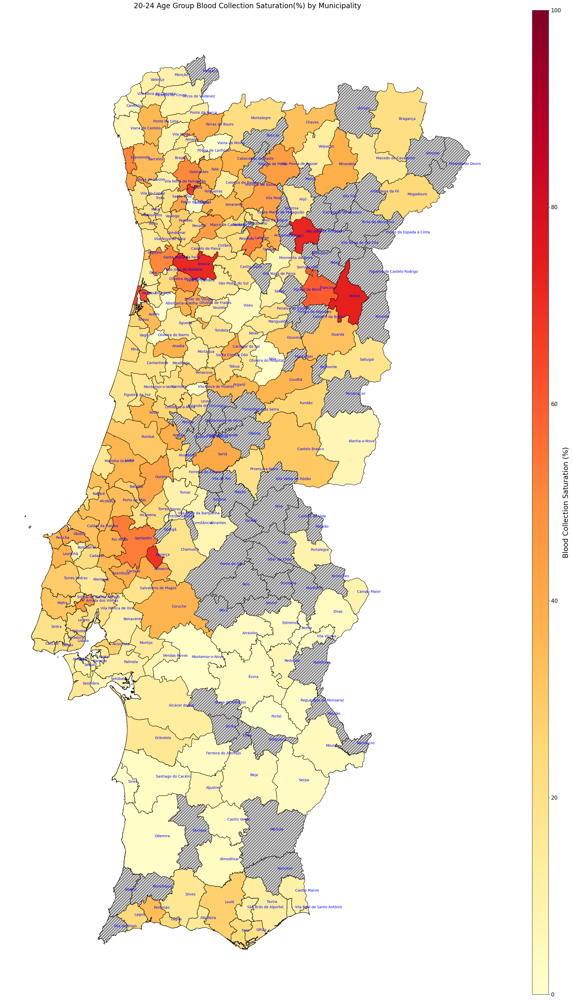

In [97]:
# Copy uf_pt2 and calculate centroids
points2 = uf_pt2.copy()

# Reproject to a projected CRS (e.g., EPSG:3857)
points2 = points2.to_crs(epsg=3857)
points2.geometry = points2.geometry.centroid

# Reproject back to the original CRS if needed
points2 = points2.to_crs(uf_pt2.crs)

# Plot the GeoDataFrame with the new 'Values' column, specifying NaN color
fig, ax = plt.subplots(figsize=(40, 50))
mapa_df_concelho.plot(column='Saturation (%)', vmin=0, vmax=100, edgecolor = 'black',cmap='YlOrRd', legend=False,
            missing_kwds={
                "color": "lightgrey",
                "edgecolor": "black",
                "hatch": "///",
                "label": "Missing values",
            }, ax=ax)
ax.set_axis_off()

cbar = plt.cm.ScalarMappable(cmap='YlOrRd', norm=plt.Normalize(vmin=0, vmax=100))
cbar.set_array([])

# Set the aspect ratio to control the thickness
colorbar = fig.colorbar(cbar, ax=ax, orientation='vertical', aspect=60, ticks=[0, 20, 40, 60, 80, 100])
colorbar.set_label('Blood Collection Saturation (%)', fontsize=20)  # Set the label font size
colorbar.ax.tick_params(labelsize=15)  # Set the ticks font size

# Set custom tick labels if desired
colorbar.set_ticks([0, 20, 40, 60, 80, 100])
colorbar.set_ticklabels(['0', '20', '40', '60', '80', '100']) # Set the ticks font size

# Annotate the plot
for x, y, label in zip(points2.geometry.x, points2.geometry.y, points2.NAME_2):
    ax.annotate(label, xy=(x, y), xytext=(3, 3), textcoords="offset points", color='blue')

# Display the plot
plt.title('20-24 Age Group Blood Collection Saturation(%) by Municipality', fontsize=20)   
plt.show()

# Mapa Saturação 25-29 Anos Concelho

In [98]:
import pandas as pd

df_ready = pd.read_excel('blood_collections_filtered.xlsx')

# Excluir os menores de 20 anos visto que os censos nao contabilizam entre 18 a 20 anos
df_ready = df_ready[~(df_ready['idade'] < 20)]

age_bins = [19, 24, 29, 34, 39, 44, 49, 54, 59, 64, 69]
age_labels = ['20-24', '25-29', '30-34', '35-39', '40-44', '45-49', '50-54', '55-59', '60-64', '65-69']

# Create the age groups
df_ready['age_group'] = pd.cut(df_ready['idade'], bins=age_bins, labels=age_labels, right=False)

# Criar a tabela que mostra a contagem de dadores por concelho, sexo e grupo etário
pivot_df = df_ready.pivot_table(
    index=['Concelho', 'dador_sexo', 'age_group'],
    aggfunc='size'
).reset_index(name='count')

pivot_df['dador_sexo'] = pivot_df['dador_sexo'].str.capitalize()

pivot_df = pivot_df[pivot_df['age_group'] == '25-29']

In [105]:
import pandas as pd

census = pd.read_excel('melted_census_data.xlsx')
census = census[census['Faxa Etaria'] == '25-29']


df_merged = census.merge(pivot_df, right_on=['Concelho', 'dador_sexo','age_group'],left_on=['Concelho', 'Sexo', 'Faxa Etaria'], how='left')
df_merged.drop(columns=['dador_sexo', 'age_group'], inplace=True)
df_merged.fillna(0, inplace=True)
df_merged.rename(columns={'count': 'Numero de Colheitas Realizadas'}, inplace=True)
df_merged['Taxa Doacao (%)'] = 2.8# Existem 6711893 pessoas entre os 20 e 69 anos em Portugal e 188601 dadores de sangue em 2020 que realizaram dadivas
df_merged['Potencial de Colheitas'] = df_merged['Numero Populacional'] * df_merged['Taxa Doacao (%)'] / 100 * df_merged['Sexo'].apply(lambda x: 3 if x == 'Feminino' else 4)


In [107]:
test_df = df_merged.pivot_table(index='Concelho', values=['Numero Populacional'], aggfunc='sum')
print(test_df['Numero Populacional'].sum())
first_quartile_value = test_df['Numero Populacional'].quantile(0.25)
print(first_quartile_value)
excludes_municipalities = test_df[test_df['Numero Populacional'] < first_quartile_value].index.tolist()

541861
246.5


In [108]:
concelho_df = df_merged.pivot_table(index='Concelho', values=['Numero de Colheitas Realizadas','Numero Populacional', 'Potencial de Colheitas'], aggfunc='sum')

concelho_df = concelho_df[~concelho_df.index.isin(excludes_municipalities)]

concelho_df["Saturation (%)"] = concelho_df["Numero de Colheitas Realizadas"] / concelho_df["Potencial de Colheitas"] * 100

concelho_df.sort_values(by='Saturation (%)', ascending=False, inplace=True)

print(concelho_df['Saturation (%)'].head(10))

Concelho
São João da Pesqueira    99.925981
Vizela                   94.420246
Arouca                   90.621184
Terras de Bouro          88.547816
Fafe                     77.516876
Ansião                   76.923077
Lamego                   76.265404
Guimarães                75.035753
Vale de Cambra           73.285128
Santarém                 72.813613
Name: Saturation (%), dtype: float64


In [109]:
%matplotlib inline

import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt

uf_pt2 = gpd.read_file('Geopandas_Portugal/Shapes/shp/gadm36_PRT_2.shp')

In [110]:
uf_pt2 = uf_pt2[uf_pt2['NAME_1'] != 'Azores']
uf_pt2 = uf_pt2[uf_pt2['NAME_1'] != 'Madeira']

mapa_df_concelho = uf_pt2.merge(concelho_df, left_on='NAME_2', right_on='Concelho', how='left')

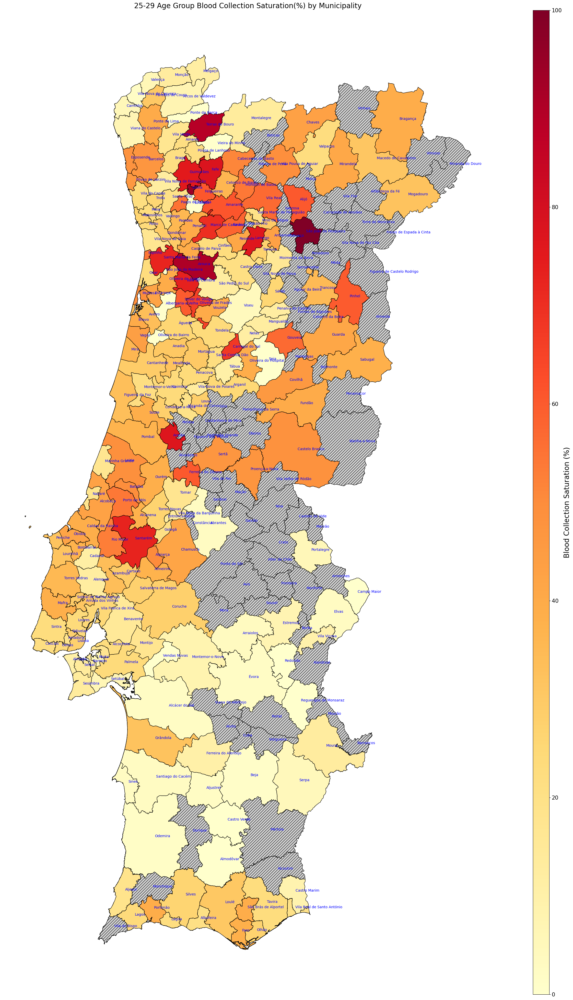

In [112]:
# Copy uf_pt2 and calculate centroids
points2 = uf_pt2.copy()

# Reproject to a projected CRS (e.g., EPSG:3857)
points2 = points2.to_crs(epsg=3857)
points2.geometry = points2.geometry.centroid

# Reproject back to the original CRS if needed
points2 = points2.to_crs(uf_pt2.crs)

# Plot the GeoDataFrame with the new 'Values' column, specifying NaN color
fig, ax = plt.subplots(figsize=(40, 50))
mapa_df_concelho.plot(column='Saturation (%)', vmin=0, vmax=100, edgecolor = 'black',cmap='YlOrRd', legend=False,
            missing_kwds={
                "color": "lightgrey",
                "edgecolor": "black",
                "hatch": "///",
                "label": "Missing values",
            }, ax=ax)
ax.set_axis_off()

cbar = plt.cm.ScalarMappable(cmap='YlOrRd', norm=plt.Normalize(vmin=0, vmax=100))
cbar.set_array([])

# Set the aspect ratio to control the thickness
colorbar = fig.colorbar(cbar, ax=ax, orientation='vertical', aspect=60, ticks=[0, 20, 40, 60, 80, 100])
colorbar.set_label('Blood Collection Saturation (%)', fontsize=20)  # Set the label font size
colorbar.ax.tick_params(labelsize=15)  # Set the ticks font size

# Set custom tick labels if desired
colorbar.set_ticks([0, 20, 40, 60, 80, 100])
colorbar.set_ticklabels(['0', '20', '40', '60', '80', '100']) # Set the ticks font size

# Annotate the plot
for x, y, label in zip(points2.geometry.x, points2.geometry.y, points2.NAME_2):
    ax.annotate(label, xy=(x, y), xytext=(3, 3), textcoords="offset points", color='blue')

# Display the plot
plt.title('25-29 Age Group Blood Collection Saturation(%) by Municipality', fontsize=20)   
plt.show()

# Mapa Saturação 30-34 Anos Concelho

In [113]:
import pandas as pd

df_ready = pd.read_excel('blood_collections_filtered.xlsx')

# Excluir os menores de 20 anos visto que os censos nao contabilizam entre 18 a 20 anos
df_ready = df_ready[~(df_ready['idade'] < 20)]

age_bins = [19, 24, 29, 34, 39, 44, 49, 54, 59, 64, 69]
age_labels = ['20-24', '25-29', '30-34', '35-39', '40-44', '45-49', '50-54', '55-59', '60-64', '65-69']

# Create the age groups
df_ready['age_group'] = pd.cut(df_ready['idade'], bins=age_bins, labels=age_labels, right=False)

# Criar a tabela que mostra a contagem de dadores por concelho, sexo e grupo etário
pivot_df = df_ready.pivot_table(
    index=['Concelho', 'dador_sexo', 'age_group'],
    aggfunc='size'
).reset_index(name='count')

pivot_df['dador_sexo'] = pivot_df['dador_sexo'].str.capitalize()

pivot_df = pivot_df[pivot_df['age_group'] == '30-34']

In [114]:
import pandas as pd

census = pd.read_excel('melted_census_data.xlsx')
census = census[census['Faxa Etaria'] == '30-34']


df_merged = census.merge(pivot_df, right_on=['Concelho', 'dador_sexo','age_group'],left_on=['Concelho', 'Sexo', 'Faxa Etaria'], how='left')
df_merged.drop(columns=['dador_sexo', 'age_group'], inplace=True)
df_merged.fillna(0, inplace=True)
df_merged.rename(columns={'count': 'Numero de Colheitas Realizadas'}, inplace=True)
df_merged['Taxa Doacao (%)'] = 2.8# Existem 6711893 pessoas entre os 20 e 69 anos em Portugal e 188601 dadores de sangue em 2020 que realizaram dadivas
df_merged['Potencial de Colheitas'] = df_merged['Numero Populacional'] * df_merged['Taxa Doacao (%)'] / 100 * df_merged['Sexo'].apply(lambda x: 3 if x == 'Feminino' else 4)


In [115]:
test_df = df_merged.pivot_table(index='Concelho', values=['Numero Populacional'], aggfunc='sum')
print(test_df['Numero Populacional'].sum())
first_quartile_value = test_df['Numero Populacional'].quantile(0.25)
print(first_quartile_value)
excludes_municipalities = test_df[test_df['Numero Populacional'] < first_quartile_value].index.tolist()

561085
261.25


In [116]:
concelho_df = df_merged.pivot_table(index='Concelho', values=['Numero de Colheitas Realizadas','Numero Populacional', 'Potencial de Colheitas'], aggfunc='sum')

concelho_df = concelho_df[~concelho_df.index.isin(excludes_municipalities)]

concelho_df["Saturation (%)"] = concelho_df["Numero de Colheitas Realizadas"] / concelho_df["Potencial de Colheitas"] * 100

concelho_df.sort_values(by='Saturation (%)', ascending=False, inplace=True)

print(concelho_df['Saturation (%)'].head(10))

Concelho
Vizela                   112.810918
São João da Pesqueira    103.990641
Lamego                    99.968637
Mirandela                 86.620469
Murtosa                   84.033613
Arouca                    81.999605
Trancoso                  78.458448
Vale de Cambra            77.683053
Guimarães                 76.712991
Santa Maria da Feira      76.600861
Name: Saturation (%), dtype: float64


In [117]:
%matplotlib inline

import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt

uf_pt2 = gpd.read_file('Geopandas_Portugal/Shapes/shp/gadm36_PRT_2.shp')

In [118]:
uf_pt2 = uf_pt2[uf_pt2['NAME_1'] != 'Azores']
uf_pt2 = uf_pt2[uf_pt2['NAME_1'] != 'Madeira']

mapa_df_concelho = uf_pt2.merge(concelho_df, left_on='NAME_2', right_on='Concelho', how='left')

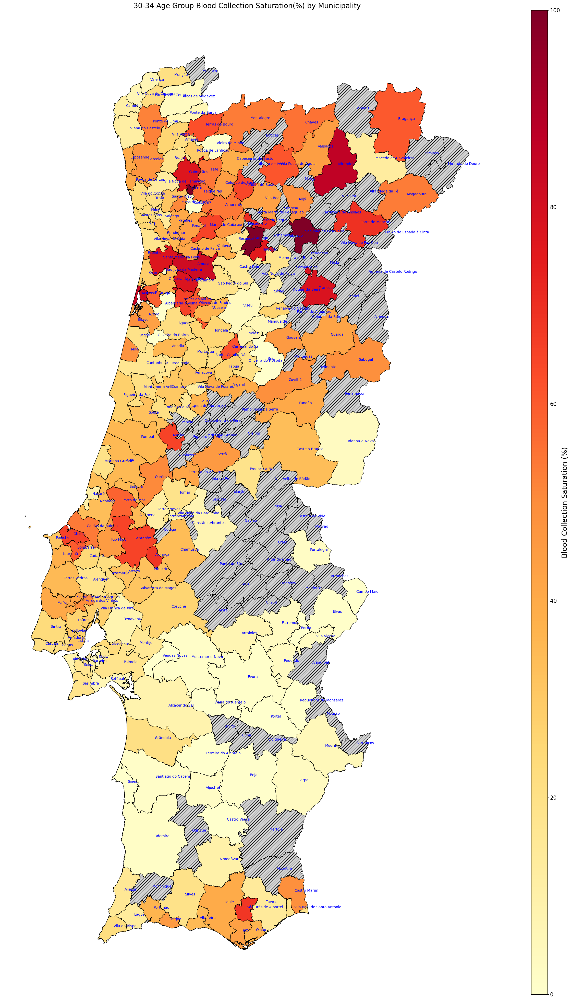

In [119]:
# Copy uf_pt2 and calculate centroids
points2 = uf_pt2.copy()

# Reproject to a projected CRS (e.g., EPSG:3857)
points2 = points2.to_crs(epsg=3857)
points2.geometry = points2.geometry.centroid

# Reproject back to the original CRS if needed
points2 = points2.to_crs(uf_pt2.crs)

# Plot the GeoDataFrame with the new 'Values' column, specifying NaN color
fig, ax = plt.subplots(figsize=(40, 50))
mapa_df_concelho.plot(column='Saturation (%)', vmin=0, vmax=100, edgecolor = 'black',cmap='YlOrRd', legend=False,
            missing_kwds={
                "color": "lightgrey",
                "edgecolor": "black",
                "hatch": "///",
                "label": "Missing values",
            }, ax=ax)
ax.set_axis_off()

cbar = plt.cm.ScalarMappable(cmap='YlOrRd', norm=plt.Normalize(vmin=0, vmax=100))
cbar.set_array([])

# Set the aspect ratio to control the thickness
colorbar = fig.colorbar(cbar, ax=ax, orientation='vertical', aspect=60, ticks=[0, 20, 40, 60, 80, 100])
colorbar.set_label('Blood Collection Saturation (%)', fontsize=20)  # Set the label font size
colorbar.ax.tick_params(labelsize=15)  # Set the ticks font size

# Set custom tick labels if desired
colorbar.set_ticks([0, 20, 40, 60, 80, 100])
colorbar.set_ticklabels(['0', '20', '40', '60', '80', '100']) # Set the ticks font size

# Annotate the plot
for x, y, label in zip(points2.geometry.x, points2.geometry.y, points2.NAME_2):
    ax.annotate(label, xy=(x, y), xytext=(3, 3), textcoords="offset points", color='blue')

# Display the plot
plt.title('30-34 Age Group Blood Collection Saturation(%) by Municipality', fontsize=20)   
plt.show()

# Mapa Saturação 35-39 Anos Concelho

In [1]:
import pandas as pd

df_ready = pd.read_excel('blood_collections_filtered.xlsx')

# Excluir os menores de 20 anos visto que os censos nao contabilizam entre 18 a 20 anos
df_ready = df_ready[~(df_ready['idade'] < 20)]

age_bins = [19, 24, 29, 34, 39, 44, 49, 54, 59, 64, 69]
age_labels = ['20-24', '25-29', '30-34', '35-39', '40-44', '45-49', '50-54', '55-59', '60-64', '65-69']

# Create the age groups
df_ready['age_group'] = pd.cut(df_ready['idade'], bins=age_bins, labels=age_labels, right=False)

# Criar a tabela que mostra a contagem de dadores por concelho, sexo e grupo etário
pivot_df = df_ready.pivot_table(
    index=['Concelho', 'dador_sexo', 'age_group'],
    aggfunc='size'
).reset_index(name='count')

pivot_df['dador_sexo'] = pivot_df['dador_sexo'].str.capitalize()

pivot_df = pivot_df[pivot_df['age_group'] == '35-39']

In [2]:
import pandas as pd

census = pd.read_excel('melted_census_data.xlsx')
census = census[census['Faxa Etaria'] == '35-39']


df_merged = census.merge(pivot_df, right_on=['Concelho', 'dador_sexo','age_group'],left_on=['Concelho', 'Sexo', 'Faxa Etaria'], how='left')
df_merged.drop(columns=['dador_sexo', 'age_group'], inplace=True)
df_merged.fillna(0, inplace=True)
df_merged.rename(columns={'count': 'Numero de Colheitas Realizadas'}, inplace=True)
df_merged['Taxa Doacao (%)'] = 2.8# Existem 6711893 pessoas entre os 20 e 69 anos em Portugal e 188601 dadores de sangue em 2020 que realizaram dadivas
df_merged['Potencial de Colheitas'] = df_merged['Numero Populacional'] * df_merged['Taxa Doacao (%)'] / 100 * df_merged['Sexo'].apply(lambda x: 3 if x == 'Feminino' else 4)


In [3]:
test_df = df_merged.pivot_table(index='Concelho', values=['Numero Populacional'], aggfunc='sum')
print(test_df['Numero Populacional'].sum())
first_quartile_value = test_df['Numero Populacional'].quantile(0.25)
print(first_quartile_value)
excludes_municipalities = test_df[test_df['Numero Populacional'] < first_quartile_value].index.tolist()

645232
318.25


In [4]:
concelho_df = df_merged.pivot_table(index='Concelho', values=['Numero de Colheitas Realizadas','Numero Populacional', 'Potencial de Colheitas'], aggfunc='sum')

concelho_df = concelho_df[~concelho_df.index.isin(excludes_municipalities)]

concelho_df["Saturation (%)"] = concelho_df["Numero de Colheitas Realizadas"] / concelho_df["Potencial de Colheitas"] * 100

concelho_df.sort_values(by='Saturation (%)', ascending=False, inplace=True)

print(concelho_df['Saturation (%)'].head(10))

Concelho
Vizela            108.341667
Arouca            108.152814
Lamego            103.160386
Pinhel             90.273076
Alpiarça           89.146423
Belmonte           83.354706
Vale de Cambra     82.306622
Trancoso           82.219938
Guimarães          81.931001
Sever do Vouga     81.484050
Name: Saturation (%), dtype: float64


In [5]:
%matplotlib inline

import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt

uf_pt2 = gpd.read_file('Geopandas_Portugal/Shapes/shp/gadm36_PRT_2.shp')

In [6]:
uf_pt2 = uf_pt2[uf_pt2['NAME_1'] != 'Azores']
uf_pt2 = uf_pt2[uf_pt2['NAME_1'] != 'Madeira']

mapa_df_concelho = uf_pt2.merge(concelho_df, left_on='NAME_2', right_on='Concelho', how='left')

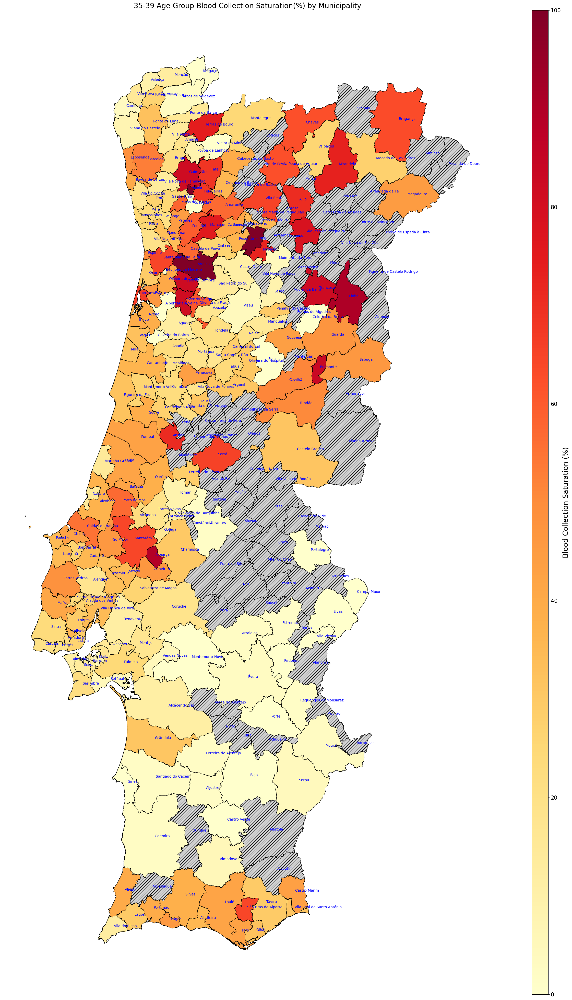

In [7]:
# Copy uf_pt2 and calculate centroids
points2 = uf_pt2.copy()

# Reproject to a projected CRS (e.g., EPSG:3857)
points2 = points2.to_crs(epsg=3857)
points2.geometry = points2.geometry.centroid

# Reproject back to the original CRS if needed
points2 = points2.to_crs(uf_pt2.crs)

# Plot the GeoDataFrame with the new 'Values' column, specifying NaN color
fig, ax = plt.subplots(figsize=(40, 50))
mapa_df_concelho.plot(column='Saturation (%)', vmin=0, vmax=100, edgecolor = 'black',cmap='YlOrRd', legend=False,
            missing_kwds={
                "color": "lightgrey",
                "edgecolor": "black",
                "hatch": "///",
                "label": "Missing values",
            }, ax=ax)
ax.set_axis_off()

cbar = plt.cm.ScalarMappable(cmap='YlOrRd', norm=plt.Normalize(vmin=0, vmax=100))
cbar.set_array([])

# Set the aspect ratio to control the thickness
colorbar = fig.colorbar(cbar, ax=ax, orientation='vertical', aspect=60, ticks=[0, 20, 40, 60, 80, 100])
colorbar.set_label('Blood Collection Saturation (%)', fontsize=20)  # Set the label font size
colorbar.ax.tick_params(labelsize=15)  # Set the ticks font size

# Set custom tick labels if desired
colorbar.set_ticks([0, 20, 40, 60, 80, 100])
colorbar.set_ticklabels(['0', '20', '40', '60', '80', '100']) # Set the ticks font size

# Annotate the plot
for x, y, label in zip(points2.geometry.x, points2.geometry.y, points2.NAME_2):
    ax.annotate(label, xy=(x, y), xytext=(3, 3), textcoords="offset points", color='blue')

# Display the plot
plt.title('35-39 Age Group Blood Collection Saturation(%) by Municipality', fontsize=20)   
plt.show()

# Mapa Saturação 40-44 Anos Concelho

In [9]:
import pandas as pd

df_ready = pd.read_excel('blood_collections_filtered.xlsx')

# Excluir os menores de 20 anos visto que os censos nao contabilizam entre 18 a 20 anos
df_ready = df_ready[~(df_ready['idade'] < 20)]

age_bins = [19, 24, 29, 34, 39, 44, 49, 54, 59, 64, 69]
age_labels = ['20-24', '25-29', '30-34', '35-39', '40-44', '45-49', '50-54', '55-59', '60-64', '65-69']

# Create the age groups
df_ready['age_group'] = pd.cut(df_ready['idade'], bins=age_bins, labels=age_labels, right=False)

# Criar a tabela que mostra a contagem de dadores por concelho, sexo e grupo etário
pivot_df = df_ready.pivot_table(
    index=['Concelho', 'dador_sexo', 'age_group'],
    aggfunc='size'
).reset_index(name='count')

pivot_df['dador_sexo'] = pivot_df['dador_sexo'].str.capitalize()

pivot_df = pivot_df[pivot_df['age_group'] == '40-44']

In [10]:
import pandas as pd

census = pd.read_excel('melted_census_data.xlsx')
census = census[census['Faxa Etaria'] == '40-44']


df_merged = census.merge(pivot_df, right_on=['Concelho', 'dador_sexo','age_group'],left_on=['Concelho', 'Sexo', 'Faxa Etaria'], how='left')
df_merged.drop(columns=['dador_sexo', 'age_group'], inplace=True)
df_merged.fillna(0, inplace=True)
df_merged.rename(columns={'count': 'Numero de Colheitas Realizadas'}, inplace=True)
df_merged['Taxa Doacao (%)'] = 2.8# Existem 6711893 pessoas entre os 20 e 69 anos em Portugal e 188601 dadores de sangue em 2020 que realizaram dadivas
df_merged['Potencial de Colheitas'] = df_merged['Numero Populacional'] * df_merged['Taxa Doacao (%)'] / 100 * df_merged['Sexo'].apply(lambda x: 3 if x == 'Feminino' else 4)


In [11]:
test_df = df_merged.pivot_table(index='Concelho', values=['Numero Populacional'], aggfunc='sum')
print(test_df['Numero Populacional'].sum())
first_quartile_value = test_df['Numero Populacional'].quantile(0.25)
print(first_quartile_value)
excludes_municipalities = test_df[test_df['Numero Populacional'] < first_quartile_value].index.tolist()

757622
385.5


In [12]:
concelho_df = df_merged.pivot_table(index='Concelho', values=['Numero de Colheitas Realizadas','Numero Populacional', 'Potencial de Colheitas'], aggfunc='sum')

concelho_df = concelho_df[~concelho_df.index.isin(excludes_municipalities)]

concelho_df["Saturation (%)"] = concelho_df["Numero de Colheitas Realizadas"] / concelho_df["Potencial de Colheitas"] * 100

concelho_df.sort_values(by='Saturation (%)', ascending=False, inplace=True)

print(concelho_df['Saturation (%)'].head(10))

Concelho
Arouca                  137.949201
Pinhel                  132.966315
Miranda do Douro        121.109050
Lamego                  114.574366
Vale de Cambra          101.567452
Guimarães                93.711211
Vizela                   91.575092
Santa Maria da Feira     91.213500
Sever do Vouga           88.696713
Marco de Canaveses       87.891423
Name: Saturation (%), dtype: float64


In [13]:
%matplotlib inline

import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt

uf_pt2 = gpd.read_file('Geopandas_Portugal/Shapes/shp/gadm36_PRT_2.shp')

In [14]:
uf_pt2 = uf_pt2[uf_pt2['NAME_1'] != 'Azores']
uf_pt2 = uf_pt2[uf_pt2['NAME_1'] != 'Madeira']

mapa_df_concelho = uf_pt2.merge(concelho_df, left_on='NAME_2', right_on='Concelho', how='left')

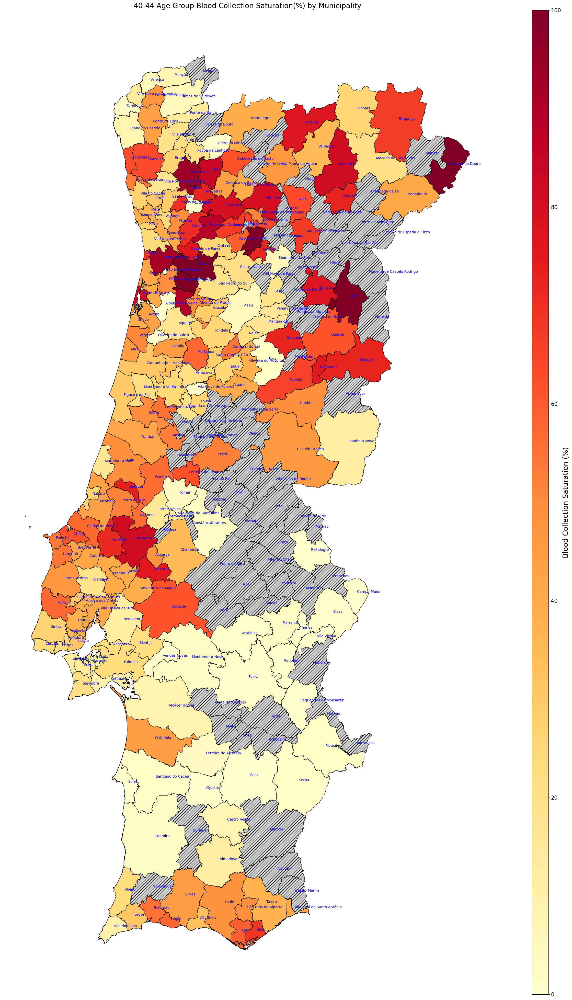

In [15]:
# Copy uf_pt2 and calculate centroids
points2 = uf_pt2.copy()

# Reproject to a projected CRS (e.g., EPSG:3857)
points2 = points2.to_crs(epsg=3857)
points2.geometry = points2.geometry.centroid

# Reproject back to the original CRS if needed
points2 = points2.to_crs(uf_pt2.crs)

# Plot the GeoDataFrame with the new 'Values' column, specifying NaN color
fig, ax = plt.subplots(figsize=(40, 50))
mapa_df_concelho.plot(column='Saturation (%)', vmin=0, vmax=100, edgecolor = 'black',cmap='YlOrRd', legend=False,
            missing_kwds={
                "color": "lightgrey",
                "edgecolor": "black",
                "hatch": "///",
                "label": "Missing values",
            }, ax=ax)
ax.set_axis_off()

cbar = plt.cm.ScalarMappable(cmap='YlOrRd', norm=plt.Normalize(vmin=0, vmax=100))
cbar.set_array([])

# Set the aspect ratio to control the thickness
colorbar = fig.colorbar(cbar, ax=ax, orientation='vertical', aspect=60, ticks=[0, 20, 40, 60, 80, 100])
colorbar.set_label('Blood Collection Saturation (%)', fontsize=20)  # Set the label font size
colorbar.ax.tick_params(labelsize=15)  # Set the ticks font size

# Set custom tick labels if desired
colorbar.set_ticks([0, 20, 40, 60, 80, 100])
colorbar.set_ticklabels(['0', '20', '40', '60', '80', '100']) # Set the ticks font size

# Annotate the plot
for x, y, label in zip(points2.geometry.x, points2.geometry.y, points2.NAME_2):
    ax.annotate(label, xy=(x, y), xytext=(3, 3), textcoords="offset points", color='blue')

# Display the plot
plt.title('40-44 Age Group Blood Collection Saturation(%) by Municipality', fontsize=20)   
plt.show()

# Mapa Saturação 45-49 Anos Concelho

In [16]:
import pandas as pd

df_ready = pd.read_excel('blood_collections_filtered.xlsx')

# Excluir os menores de 20 anos visto que os censos nao contabilizam entre 18 a 20 anos
df_ready = df_ready[~(df_ready['idade'] < 20)]

age_bins = [19, 24, 29, 34, 39, 44, 49, 54, 59, 64, 69]
age_labels = ['20-24', '25-29', '30-34', '35-39', '40-44', '45-49', '50-54', '55-59', '60-64', '65-69']

# Create the age groups
df_ready['age_group'] = pd.cut(df_ready['idade'], bins=age_bins, labels=age_labels, right=False)

# Criar a tabela que mostra a contagem de dadores por concelho, sexo e grupo etário
pivot_df = df_ready.pivot_table(
    index=['Concelho', 'dador_sexo', 'age_group'],
    aggfunc='size'
).reset_index(name='count')

pivot_df['dador_sexo'] = pivot_df['dador_sexo'].str.capitalize()

pivot_df = pivot_df[pivot_df['age_group'] == '45-49']

In [17]:
import pandas as pd

census = pd.read_excel('melted_census_data.xlsx')
census = census[census['Faxa Etaria'] == '45-49']


df_merged = census.merge(pivot_df, right_on=['Concelho', 'dador_sexo','age_group'],left_on=['Concelho', 'Sexo', 'Faxa Etaria'], how='left')
df_merged.drop(columns=['dador_sexo', 'age_group'], inplace=True)
df_merged.fillna(0, inplace=True)
df_merged.rename(columns={'count': 'Numero de Colheitas Realizadas'}, inplace=True)
df_merged['Taxa Doacao (%)'] = 2.8# Existem 6711893 pessoas entre os 20 e 69 anos em Portugal e 188601 dadores de sangue em 2020 que realizaram dadivas
df_merged['Potencial de Colheitas'] = df_merged['Numero Populacional'] * df_merged['Taxa Doacao (%)'] / 100 * df_merged['Sexo'].apply(lambda x: 3 if x == 'Feminino' else 4)


In [18]:
test_df = df_merged.pivot_table(index='Concelho', values=['Numero Populacional'], aggfunc='sum')
print(test_df['Numero Populacional'].sum())
first_quartile_value = test_df['Numero Populacional'].quantile(0.25)
print(first_quartile_value)
excludes_municipalities = test_df[test_df['Numero Populacional'] < first_quartile_value].index.tolist()

797793
415.25


In [19]:
concelho_df = df_merged.pivot_table(index='Concelho', values=['Numero de Colheitas Realizadas','Numero Populacional', 'Potencial de Colheitas'], aggfunc='sum')

concelho_df = concelho_df[~concelho_df.index.isin(excludes_municipalities)]

concelho_df["Saturation (%)"] = concelho_df["Numero de Colheitas Realizadas"] / concelho_df["Potencial de Colheitas"] * 100

concelho_df.sort_values(by='Saturation (%)', ascending=False, inplace=True)

print(concelho_df['Saturation (%)'].head(10))

Concelho
Arouca                  145.772595
Alpiarça                138.475529
Lamego                  123.348719
Vizela                  115.107018
Vale de Cambra          102.560108
Santarém                 99.981985
Santa Maria da Feira     99.953361
Sever do Vouga           99.601594
Guimarães                99.080942
Trancoso                 90.100452
Name: Saturation (%), dtype: float64


In [20]:
%matplotlib inline

import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt

uf_pt2 = gpd.read_file('Geopandas_Portugal/Shapes/shp/gadm36_PRT_2.shp')

In [21]:
uf_pt2 = uf_pt2[uf_pt2['NAME_1'] != 'Azores']
uf_pt2 = uf_pt2[uf_pt2['NAME_1'] != 'Madeira']

mapa_df_concelho = uf_pt2.merge(concelho_df, left_on='NAME_2', right_on='Concelho', how='left')

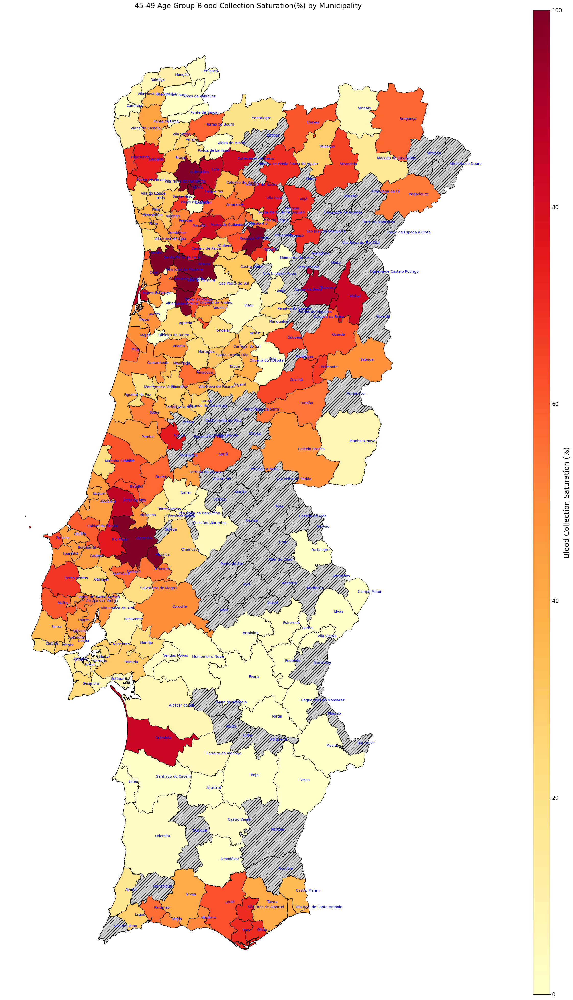

In [22]:
# Copy uf_pt2 and calculate centroids
points2 = uf_pt2.copy()

# Reproject to a projected CRS (e.g., EPSG:3857)
points2 = points2.to_crs(epsg=3857)
points2.geometry = points2.geometry.centroid

# Reproject back to the original CRS if needed
points2 = points2.to_crs(uf_pt2.crs)

# Plot the GeoDataFrame with the new 'Values' column, specifying NaN color
fig, ax = plt.subplots(figsize=(40, 50))
mapa_df_concelho.plot(column='Saturation (%)', vmin=0, vmax=100, edgecolor = 'black',cmap='YlOrRd', legend=False,
            missing_kwds={
                "color": "lightgrey",
                "edgecolor": "black",
                "hatch": "///",
                "label": "Missing values",
            }, ax=ax)
ax.set_axis_off()

cbar = plt.cm.ScalarMappable(cmap='YlOrRd', norm=plt.Normalize(vmin=0, vmax=100))
cbar.set_array([])

# Set the aspect ratio to control the thickness
colorbar = fig.colorbar(cbar, ax=ax, orientation='vertical', aspect=60, ticks=[0, 20, 40, 60, 80, 100])
colorbar.set_label('Blood Collection Saturation (%)', fontsize=20)  # Set the label font size
colorbar.ax.tick_params(labelsize=15)  # Set the ticks font size

# Set custom tick labels if desired
colorbar.set_ticks([0, 20, 40, 60, 80, 100])
colorbar.set_ticklabels(['0', '20', '40', '60', '80', '100']) # Set the ticks font size

# Annotate the plot
for x, y, label in zip(points2.geometry.x, points2.geometry.y, points2.NAME_2):
    ax.annotate(label, xy=(x, y), xytext=(3, 3), textcoords="offset points", color='blue')

# Display the plot
plt.title('45-49 Age Group Blood Collection Saturation(%) by Municipality', fontsize=20)   
plt.show()

# Mapa Saturação 50-54 Anos Concelho

In [23]:
import pandas as pd

df_ready = pd.read_excel('blood_collections_filtered.xlsx')

# Excluir os menores de 20 anos visto que os censos nao contabilizam entre 18 a 20 anos
df_ready = df_ready[~(df_ready['idade'] < 20)]

age_bins = [19, 24, 29, 34, 39, 44, 49, 54, 59, 64, 69]
age_labels = ['20-24', '25-29', '30-34', '35-39', '40-44', '45-49', '50-54', '55-59', '60-64', '65-69']

# Create the age groups
df_ready['age_group'] = pd.cut(df_ready['idade'], bins=age_bins, labels=age_labels, right=False)

# Criar a tabela que mostra a contagem de dadores por concelho, sexo e grupo etário
pivot_df = df_ready.pivot_table(
    index=['Concelho', 'dador_sexo', 'age_group'],
    aggfunc='size'
).reset_index(name='count')

pivot_df['dador_sexo'] = pivot_df['dador_sexo'].str.capitalize()

pivot_df = pivot_df[pivot_df['age_group'] == '50-54']

In [24]:
import pandas as pd

census = pd.read_excel('melted_census_data.xlsx')
census = census[census['Faxa Etaria'] == '50-54']


df_merged = census.merge(pivot_df, right_on=['Concelho', 'dador_sexo','age_group'],left_on=['Concelho', 'Sexo', 'Faxa Etaria'], how='left')
df_merged.drop(columns=['dador_sexo', 'age_group'], inplace=True)
df_merged.fillna(0, inplace=True)
df_merged.rename(columns={'count': 'Numero de Colheitas Realizadas'}, inplace=True)
df_merged['Taxa Doacao (%)'] = 2.8# Existem 6711893 pessoas entre os 20 e 69 anos em Portugal e 188601 dadores de sangue em 2020 que realizaram dadivas
df_merged['Potencial de Colheitas'] = df_merged['Numero Populacional'] * df_merged['Taxa Doacao (%)'] / 100 * df_merged['Sexo'].apply(lambda x: 3 if x == 'Feminino' else 4)


In [25]:
test_df = df_merged.pivot_table(index='Concelho', values=['Numero Populacional'], aggfunc='sum')
print(test_df['Numero Populacional'].sum())
first_quartile_value = test_df['Numero Populacional'].quantile(0.25)
print(first_quartile_value)
excludes_municipalities = test_df[test_df['Numero Populacional'] < first_quartile_value].index.tolist()

748929
433.25


In [26]:
concelho_df = df_merged.pivot_table(index='Concelho', values=['Numero de Colheitas Realizadas','Numero Populacional', 'Potencial de Colheitas'], aggfunc='sum')

concelho_df = concelho_df[~concelho_df.index.isin(excludes_municipalities)]

concelho_df["Saturation (%)"] = concelho_df["Numero de Colheitas Realizadas"] / concelho_df["Potencial de Colheitas"] * 100

concelho_df.sort_values(by='Saturation (%)', ascending=False, inplace=True)

print(concelho_df['Saturation (%)'].head(10))

Concelho
Arouca                  117.237177
Vizela                  107.236106
Vale de Cambra          106.609808
Santa Maria da Feira     97.329299
Santarém                 83.514489
Porto de Mós             81.263198
Lamego                   79.584703
Guimarães                77.353258
Felgueiras               76.884454
Marco de Canaveses       76.329744
Name: Saturation (%), dtype: float64


In [27]:
%matplotlib inline

import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt

uf_pt2 = gpd.read_file('Geopandas_Portugal/Shapes/shp/gadm36_PRT_2.shp')

In [28]:
uf_pt2 = uf_pt2[uf_pt2['NAME_1'] != 'Azores']
uf_pt2 = uf_pt2[uf_pt2['NAME_1'] != 'Madeira']

mapa_df_concelho = uf_pt2.merge(concelho_df, left_on='NAME_2', right_on='Concelho', how='left')

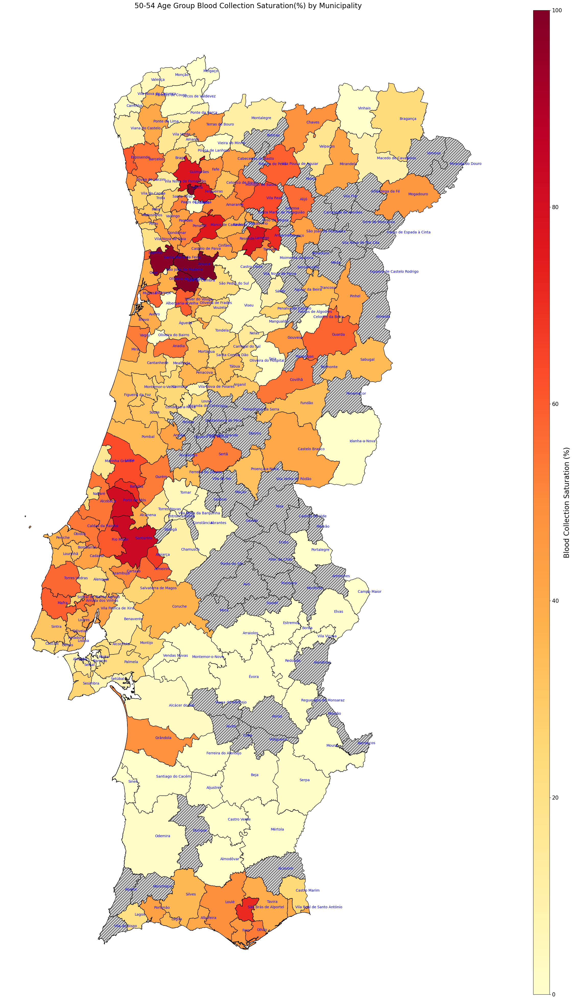

In [29]:
# Copy uf_pt2 and calculate centroids
points2 = uf_pt2.copy()

# Reproject to a projected CRS (e.g., EPSG:3857)
points2 = points2.to_crs(epsg=3857)
points2.geometry = points2.geometry.centroid

# Reproject back to the original CRS if needed
points2 = points2.to_crs(uf_pt2.crs)

# Plot the GeoDataFrame with the new 'Values' column, specifying NaN color
fig, ax = plt.subplots(figsize=(40, 50))
mapa_df_concelho.plot(column='Saturation (%)', vmin=0, vmax=100, edgecolor = 'black',cmap='YlOrRd', legend=False,
            missing_kwds={
                "color": "lightgrey",
                "edgecolor": "black",
                "hatch": "///",
                "label": "Missing values",
            }, ax=ax)
ax.set_axis_off()

cbar = plt.cm.ScalarMappable(cmap='YlOrRd', norm=plt.Normalize(vmin=0, vmax=100))
cbar.set_array([])

# Set the aspect ratio to control the thickness
colorbar = fig.colorbar(cbar, ax=ax, orientation='vertical', aspect=60, ticks=[0, 20, 40, 60, 80, 100])
colorbar.set_label('Blood Collection Saturation (%)', fontsize=20)  # Set the label font size
colorbar.ax.tick_params(labelsize=15)  # Set the ticks font size

# Set custom tick labels if desired
colorbar.set_ticks([0, 20, 40, 60, 80, 100])
colorbar.set_ticklabels(['0', '20', '40', '60', '80', '100']) # Set the ticks font size

# Annotate the plot
for x, y, label in zip(points2.geometry.x, points2.geometry.y, points2.NAME_2):
    ax.annotate(label, xy=(x, y), xytext=(3, 3), textcoords="offset points", color='blue')

# Display the plot
plt.title('50-54 Age Group Blood Collection Saturation(%) by Municipality', fontsize=20)   
plt.show()

# Mapa Saturação 55-59 Anos Concelho

In [30]:
import pandas as pd

df_ready = pd.read_excel('blood_collections_filtered.xlsx')

# Excluir os menores de 20 anos visto que os censos nao contabilizam entre 18 a 20 anos
df_ready = df_ready[~(df_ready['idade'] < 20)]

age_bins = [19, 24, 29, 34, 39, 44, 49, 54, 59, 64, 69]
age_labels = ['20-24', '25-29', '30-34', '35-39', '40-44', '45-49', '50-54', '55-59', '60-64', '65-69']

# Create the age groups
df_ready['age_group'] = pd.cut(df_ready['idade'], bins=age_bins, labels=age_labels, right=False)

# Criar a tabela que mostra a contagem de dadores por concelho, sexo e grupo etário
pivot_df = df_ready.pivot_table(
    index=['Concelho', 'dador_sexo', 'age_group'],
    aggfunc='size'
).reset_index(name='count')

pivot_df['dador_sexo'] = pivot_df['dador_sexo'].str.capitalize()

pivot_df = pivot_df[pivot_df['age_group'] == '55-59']

In [31]:
import pandas as pd

census = pd.read_excel('melted_census_data.xlsx')
census = census[census['Faxa Etaria'] == '55-59']


df_merged = census.merge(pivot_df, right_on=['Concelho', 'dador_sexo','age_group'],left_on=['Concelho', 'Sexo', 'Faxa Etaria'], how='left')
df_merged.drop(columns=['dador_sexo', 'age_group'], inplace=True)
df_merged.fillna(0, inplace=True)
df_merged.rename(columns={'count': 'Numero de Colheitas Realizadas'}, inplace=True)
df_merged['Taxa Doacao (%)'] = 2.8# Existem 6711893 pessoas entre os 20 e 69 anos em Portugal e 188601 dadores de sangue em 2020 que realizaram dadivas
df_merged['Potencial de Colheitas'] = df_merged['Numero Populacional'] * df_merged['Taxa Doacao (%)'] / 100 * df_merged['Sexo'].apply(lambda x: 3 if x == 'Feminino' else 4)


In [32]:
test_df = df_merged.pivot_table(index='Concelho', values=['Numero Populacional'], aggfunc='sum')
print(test_df['Numero Populacional'].sum())
first_quartile_value = test_df['Numero Populacional'].quantile(0.25)
print(first_quartile_value)
excludes_municipalities = test_df[test_df['Numero Populacional'] < first_quartile_value].index.tolist()

743288
478.75


In [33]:
concelho_df = df_merged.pivot_table(index='Concelho', values=['Numero de Colheitas Realizadas','Numero Populacional', 'Potencial de Colheitas'], aggfunc='sum')

concelho_df = concelho_df[~concelho_df.index.isin(excludes_municipalities)]

concelho_df["Saturation (%)"] = concelho_df["Numero de Colheitas Realizadas"] / concelho_df["Potencial de Colheitas"] * 100

concelho_df.sort_values(by='Saturation (%)', ascending=False, inplace=True)

print(concelho_df['Saturation (%)'].head(10))

Concelho
Arouca                  112.801745
Alpiarça                112.146308
Vale de Cambra           97.972620
Santa Maria da Feira     84.821429
Santarém                 81.332262
Porto de Mós             65.451492
Vizela                   63.611860
Leiria                   59.314508
Sertã                    57.938430
Lamego                   57.319224
Name: Saturation (%), dtype: float64


In [34]:
%matplotlib inline

import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt

uf_pt2 = gpd.read_file('Geopandas_Portugal/Shapes/shp/gadm36_PRT_2.shp')

In [35]:
uf_pt2 = uf_pt2[uf_pt2['NAME_1'] != 'Azores']
uf_pt2 = uf_pt2[uf_pt2['NAME_1'] != 'Madeira']

mapa_df_concelho = uf_pt2.merge(concelho_df, left_on='NAME_2', right_on='Concelho', how='left')

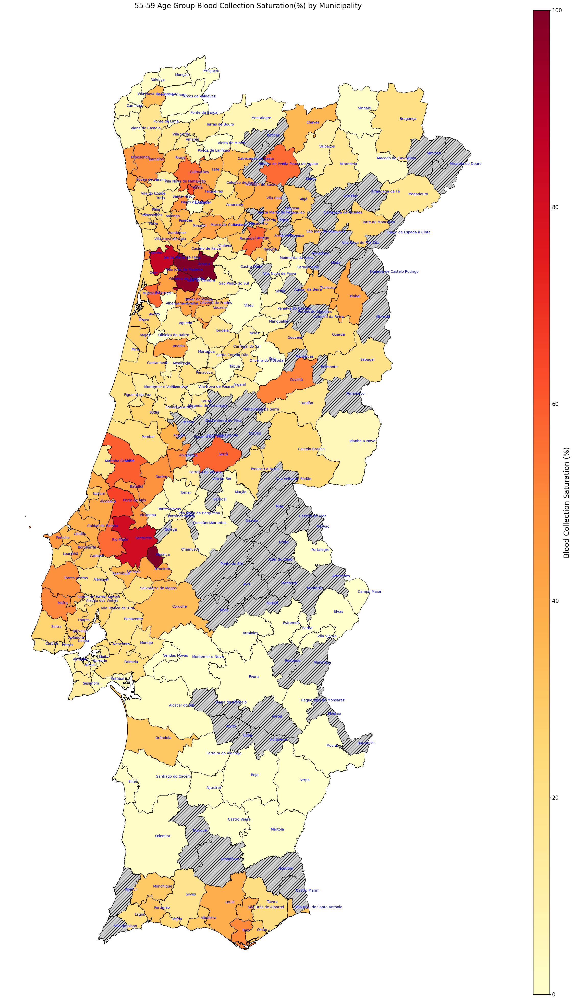

In [36]:
# Copy uf_pt2 and calculate centroids
points2 = uf_pt2.copy()

# Reproject to a projected CRS (e.g., EPSG:3857)
points2 = points2.to_crs(epsg=3857)
points2.geometry = points2.geometry.centroid

# Reproject back to the original CRS if needed
points2 = points2.to_crs(uf_pt2.crs)

# Plot the GeoDataFrame with the new 'Values' column, specifying NaN color
fig, ax = plt.subplots(figsize=(40, 50))
mapa_df_concelho.plot(column='Saturation (%)', vmin=0, vmax=100, edgecolor = 'black',cmap='YlOrRd', legend=False,
            missing_kwds={
                "color": "lightgrey",
                "edgecolor": "black",
                "hatch": "///",
                "label": "Missing values",
            }, ax=ax)
ax.set_axis_off()

cbar = plt.cm.ScalarMappable(cmap='YlOrRd', norm=plt.Normalize(vmin=0, vmax=100))
cbar.set_array([])

# Set the aspect ratio to control the thickness
colorbar = fig.colorbar(cbar, ax=ax, orientation='vertical', aspect=60, ticks=[0, 20, 40, 60, 80, 100])
colorbar.set_label('Blood Collection Saturation (%)', fontsize=20)  # Set the label font size
colorbar.ax.tick_params(labelsize=15)  # Set the ticks font size

# Set custom tick labels if desired
colorbar.set_ticks([0, 20, 40, 60, 80, 100])
colorbar.set_ticklabels(['0', '20', '40', '60', '80', '100']) # Set the ticks font size

# Annotate the plot
for x, y, label in zip(points2.geometry.x, points2.geometry.y, points2.NAME_2):
    ax.annotate(label, xy=(x, y), xytext=(3, 3), textcoords="offset points", color='blue')

# Display the plot
plt.title('55-59 Age Group Blood Collection Saturation(%) by Municipality', fontsize=20)   
plt.show()

# Mapa Saturação 60-64 Anos Concelho

In [37]:
import pandas as pd

df_ready = pd.read_excel('blood_collections_filtered.xlsx')

# Excluir os menores de 20 anos visto que os censos nao contabilizam entre 18 a 20 anos
df_ready = df_ready[~(df_ready['idade'] < 20)]

age_bins = [19, 24, 29, 34, 39, 44, 49, 54, 59, 64, 69]
age_labels = ['20-24', '25-29', '30-34', '35-39', '40-44', '45-49', '50-54', '55-59', '60-64', '65-69']

# Create the age groups
df_ready['age_group'] = pd.cut(df_ready['idade'], bins=age_bins, labels=age_labels, right=False)

# Criar a tabela que mostra a contagem de dadores por concelho, sexo e grupo etário
pivot_df = df_ready.pivot_table(
    index=['Concelho', 'dador_sexo', 'age_group'],
    aggfunc='size'
).reset_index(name='count')

pivot_df['dador_sexo'] = pivot_df['dador_sexo'].str.capitalize()

pivot_df = pivot_df[pivot_df['age_group'] == '60-64']

In [38]:
import pandas as pd

census = pd.read_excel('melted_census_data.xlsx')
census = census[census['Faxa Etaria'] == '60-64']


df_merged = census.merge(pivot_df, right_on=['Concelho', 'dador_sexo','age_group'],left_on=['Concelho', 'Sexo', 'Faxa Etaria'], how='left')
df_merged.drop(columns=['dador_sexo', 'age_group'], inplace=True)
df_merged.fillna(0, inplace=True)
df_merged.rename(columns={'count': 'Numero de Colheitas Realizadas'}, inplace=True)
df_merged['Taxa Doacao (%)'] = 2.8# Existem 6711893 pessoas entre os 20 e 69 anos em Portugal e 188601 dadores de sangue em 2020 que realizaram dadivas
df_merged['Potencial de Colheitas'] = df_merged['Numero Populacional'] * df_merged['Taxa Doacao (%)'] / 100 * df_merged['Sexo'].apply(lambda x: 3 if x == 'Feminino' else 4)


In [39]:
test_df = df_merged.pivot_table(index='Concelho', values=['Numero Populacional'], aggfunc='sum')
print(test_df['Numero Populacional'].sum())
first_quartile_value = test_df['Numero Populacional'].quantile(0.25)
print(first_quartile_value)
excludes_municipalities = test_df[test_df['Numero Populacional'] < first_quartile_value].index.tolist()

704342
495.25


In [40]:
concelho_df = df_merged.pivot_table(index='Concelho', values=['Numero de Colheitas Realizadas','Numero Populacional', 'Potencial de Colheitas'], aggfunc='sum')

concelho_df = concelho_df[~concelho_df.index.isin(excludes_municipalities)]

concelho_df["Saturation (%)"] = concelho_df["Numero de Colheitas Realizadas"] / concelho_df["Potencial de Colheitas"] * 100

concelho_df.sort_values(by='Saturation (%)', ascending=False, inplace=True)

print(concelho_df['Saturation (%)'].head(10))

Concelho
Arouca                  64.763344
Santa Maria da Feira    64.302097
Vale de Cambra          63.182886
Santarém                54.244366
Rio Maior               48.934153
Batalha                 46.431414
Miranda do Douro        43.620502
Leiria                  41.383316
Marco de Canaveses      41.276176
Sertã                   39.390756
Name: Saturation (%), dtype: float64


In [41]:
%matplotlib inline

import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt

uf_pt2 = gpd.read_file('Geopandas_Portugal/Shapes/shp/gadm36_PRT_2.shp')

In [42]:
uf_pt2 = uf_pt2[uf_pt2['NAME_1'] != 'Azores']
uf_pt2 = uf_pt2[uf_pt2['NAME_1'] != 'Madeira']

mapa_df_concelho = uf_pt2.merge(concelho_df, left_on='NAME_2', right_on='Concelho', how='left')

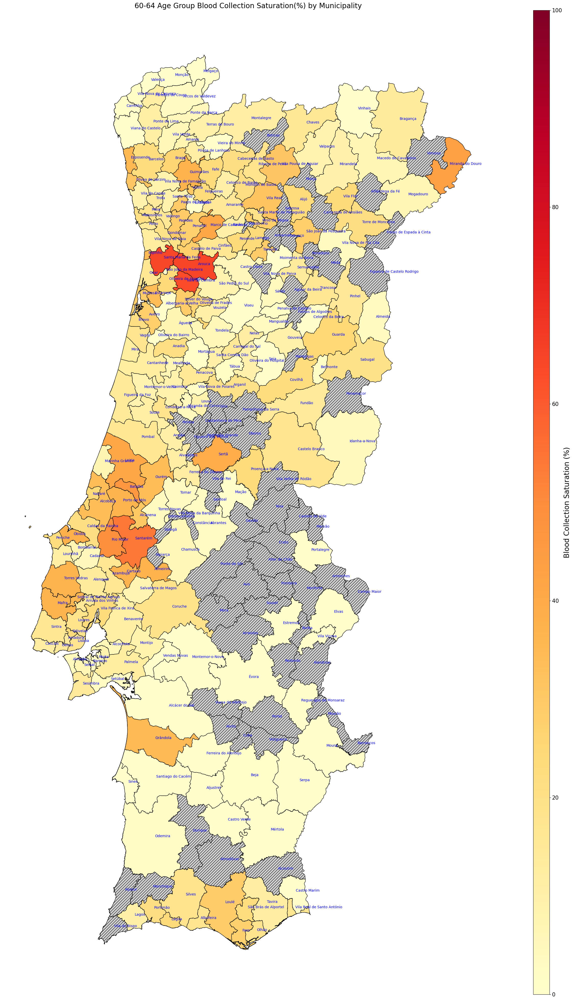

In [43]:
# Copy uf_pt2 and calculate centroids
points2 = uf_pt2.copy()

# Reproject to a projected CRS (e.g., EPSG:3857)
points2 = points2.to_crs(epsg=3857)
points2.geometry = points2.geometry.centroid

# Reproject back to the original CRS if needed
points2 = points2.to_crs(uf_pt2.crs)

# Plot the GeoDataFrame with the new 'Values' column, specifying NaN color
fig, ax = plt.subplots(figsize=(40, 50))
mapa_df_concelho.plot(column='Saturation (%)', vmin=0, vmax=100, edgecolor = 'black',cmap='YlOrRd', legend=False,
            missing_kwds={
                "color": "lightgrey",
                "edgecolor": "black",
                "hatch": "///",
                "label": "Missing values",
            }, ax=ax)
ax.set_axis_off()

cbar = plt.cm.ScalarMappable(cmap='YlOrRd', norm=plt.Normalize(vmin=0, vmax=100))
cbar.set_array([])

# Set the aspect ratio to control the thickness
colorbar = fig.colorbar(cbar, ax=ax, orientation='vertical', aspect=60, ticks=[0, 20, 40, 60, 80, 100])
colorbar.set_label('Blood Collection Saturation (%)', fontsize=20)  # Set the label font size
colorbar.ax.tick_params(labelsize=15)  # Set the ticks font size

# Set custom tick labels if desired
colorbar.set_ticks([0, 20, 40, 60, 80, 100])
colorbar.set_ticklabels(['0', '20', '40', '60', '80', '100']) # Set the ticks font size

# Annotate the plot
for x, y, label in zip(points2.geometry.x, points2.geometry.y, points2.NAME_2):
    ax.annotate(label, xy=(x, y), xytext=(3, 3), textcoords="offset points", color='blue')

# Display the plot
plt.title('60-64 Age Group Blood Collection Saturation(%) by Municipality', fontsize=20)   
plt.show()

# Mapa Saturação 65-69 Anos Concelho

In [50]:
import pandas as pd

df_ready = pd.read_excel('blood_collections_filtered.xlsx')

# Excluir os menores de 20 anos visto que os censos nao contabilizam entre 18 a 20 anos
df_ready = df_ready[~(df_ready['idade'] < 20)]

age_bins = [19, 24, 29, 34, 39, 44, 49, 54, 59, 64, 69]
age_labels = ['20-24', '25-29', '30-34', '35-39', '40-44', '45-49', '50-54', '55-59', '60-64', '65-69']

# Create the age groups
df_ready['age_group'] = pd.cut(df_ready['idade'], bins=age_bins, labels=age_labels, right=False)

# Criar a tabela que mostra a contagem de dadores por concelho, sexo e grupo etário
pivot_df = df_ready.pivot_table(
    index=['Concelho', 'dador_sexo', 'age_group'],
    aggfunc='size'
).reset_index(name='count')

pivot_df['dador_sexo'] = pivot_df['dador_sexo'].str.capitalize()

pivot_df = pivot_df[pivot_df['age_group'] == '65-69']

In [51]:
import pandas as pd

census = pd.read_excel('melted_census_data.xlsx')
census = census[census['Faxa Etaria'] == '65-69']


df_merged = census.merge(pivot_df, right_on=['Concelho', 'dador_sexo','age_group'],left_on=['Concelho', 'Sexo', 'Faxa Etaria'], how='left')
df_merged.drop(columns=['dador_sexo', 'age_group'], inplace=True)
df_merged.fillna(0, inplace=True)
df_merged.rename(columns={'count': 'Numero de Colheitas Realizadas'}, inplace=True)
df_merged['Taxa Doacao (%)'] = 2.8# Existem 6711893 pessoas entre os 20 e 69 anos em Portugal e 188601 dadores de sangue em 2020 que realizaram dadivas
df_merged['Potencial de Colheitas'] = df_merged['Numero Populacional'] * df_merged['Taxa Doacao (%)'] / 100 * df_merged['Sexo'].apply(lambda x: 3 if x == 'Feminino' else 4)


In [52]:
test_df = df_merged.pivot_table(index='Concelho', values=['Numero Populacional'], aggfunc='sum')
print(test_df['Numero Populacional'].sum())
first_quartile_value = test_df['Numero Populacional'].quantile(0.25)
print(first_quartile_value)
excludes_municipalities = test_df[test_df['Numero Populacional'] < first_quartile_value].index.tolist()

651844
480.0


In [53]:
concelho_df = df_merged.pivot_table(index='Concelho', values=['Numero de Colheitas Realizadas','Numero Populacional', 'Potencial de Colheitas'], aggfunc='sum')

concelho_df = concelho_df[~concelho_df.index.isin(excludes_municipalities)]

concelho_df["Saturation (%)"] = concelho_df["Numero de Colheitas Realizadas"] / concelho_df["Potencial de Colheitas"] * 100

concelho_df.sort_values(by='Saturation (%)', ascending=False, inplace=True)

print(concelho_df['Saturation (%)'].head(10))

Concelho
Alpiarça                30.403762
Vale de Cambra          26.008627
Santarém                24.899572
Arouca                  19.421666
Santa Maria da Feira    19.340733
Mondim de Basto         18.841065
Espinho                 18.362101
Almeida                 18.262987
Vila Real               17.571604
Esposende               16.162596
Name: Saturation (%), dtype: float64


In [54]:
%matplotlib inline

import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt

uf_pt2 = gpd.read_file('Geopandas_Portugal/Shapes/shp/gadm36_PRT_2.shp')

In [55]:
uf_pt2 = uf_pt2[uf_pt2['NAME_1'] != 'Azores']
uf_pt2 = uf_pt2[uf_pt2['NAME_1'] != 'Madeira']

mapa_df_concelho = uf_pt2.merge(concelho_df, left_on='NAME_2', right_on='Concelho', how='left')

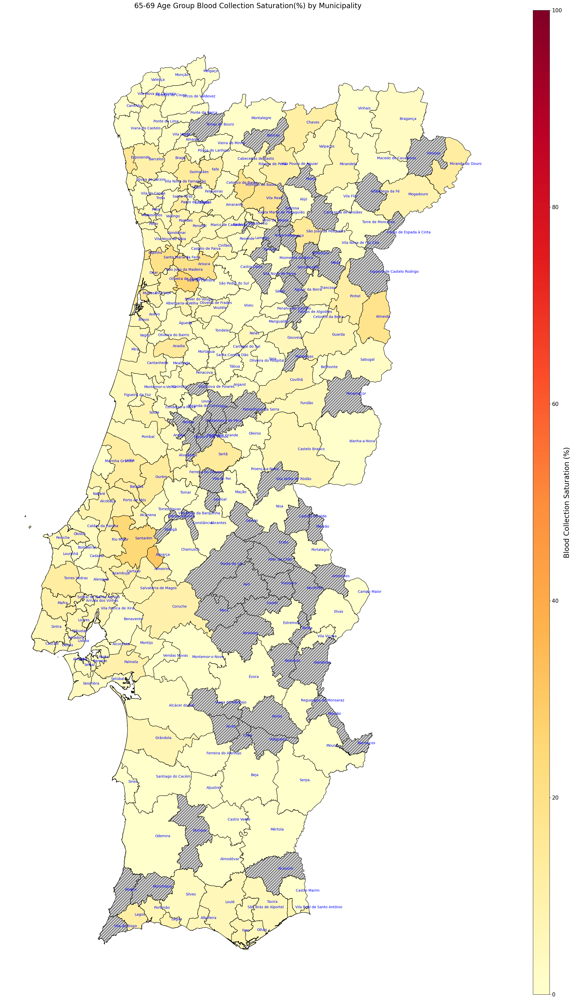

In [56]:
# Copy uf_pt2 and calculate centroids
points2 = uf_pt2.copy()

# Reproject to a projected CRS (e.g., EPSG:3857)
points2 = points2.to_crs(epsg=3857)
points2.geometry = points2.geometry.centroid

# Reproject back to the original CRS if needed
points2 = points2.to_crs(uf_pt2.crs)

# Plot the GeoDataFrame with the new 'Values' column, specifying NaN color
fig, ax = plt.subplots(figsize=(40, 50))
mapa_df_concelho.plot(column='Saturation (%)', vmin=0, vmax=100, edgecolor = 'black',cmap='YlOrRd', legend=False,
            missing_kwds={
                "color": "lightgrey",
                "edgecolor": "black",
                "hatch": "///",
                "label": "Missing values",
            }, ax=ax)
ax.set_axis_off()

cbar = plt.cm.ScalarMappable(cmap='YlOrRd', norm=plt.Normalize(vmin=0, vmax=100))
cbar.set_array([])

# Set the aspect ratio to control the thickness
colorbar = fig.colorbar(cbar, ax=ax, orientation='vertical', aspect=60, ticks=[0, 20, 40, 60, 80, 100])
colorbar.set_label('Blood Collection Saturation (%)', fontsize=20)  # Set the label font size
colorbar.ax.tick_params(labelsize=15)  # Set the ticks font size

# Set custom tick labels if desired
colorbar.set_ticks([0, 20, 40, 60, 80, 100])
colorbar.set_ticklabels(['0', '20', '40', '60', '80', '100']) # Set the ticks font size

# Annotate the plot
for x, y, label in zip(points2.geometry.x, points2.geometry.y, points2.NAME_2):
    ax.annotate(label, xy=(x, y), xytext=(3, 3), textcoords="offset points", color='blue')

# Display the plot
plt.title('65-69 Age Group Blood Collection Saturation(%) by Municipality', fontsize=20)   
plt.show()